In [1]:
from astropy.io import fits
from astropy.nddata.utils import block_reduce
import astropy.units as u
import matplotlib.pyplot as plt
from matplotlib import cm
from numba import jit
import numpy as np
from scipy.interpolate import interp1d
import scipy.ndimage
import scipy.optimize
import skimage.transform

import multiprocessing
import os
from pathlib import Path
import re

# File wrangling

In [2]:
level_1_dir = Path("/home/sam/hinodedata/level1/SOT/FG")

In [3]:
# The data has been calibrated and liberated from IDL.
# Give the files appropriate names
for fname in level_1_dir.iterdir():
    if fname.suffix != '.fits':
        continue
    h = fits.getheader(fname)
    outname = f"{h['date_obs']}-{h['campsum']}x{h['camssum']}-{h['wave']}.fits"
    fname.rename(level_1_dir/outname)

In [4]:
# Plot the data files

def plot_file(fname):
    data = fits.getdata(fname)
    plt.imsave(fname.with_suffix('.jpg'), data, cmap='viridis')

files = [fname for fname in level_1_dir.iterdir() if fname.suffix == '.fits']
with multiprocessing.Pool() as p:
    p.map(plot_file, files)

# Alignment data

Alignment data copied from previous runs. Since they're almost exactly the same, and Shimizu+2007 supports a single, fixed scale and offset between wavelengths, let's use the average for everything

In [5]:
align_fits = """Scale factors: 0.99207, 0.99600
Scale factors: 0.99203, 0.99595
Scale factors: 0.99212, 0.99598
Scale factors: 0.99207, 0.99600
Scale factors: 0.99214, 0.99604
Scale factors: 0.99206, 0.99604
Scale factors: 0.99215, 0.99613
Scale factors: 0.99214, 0.99604
Scale factors: 0.99216, 0.99609
Scale factors: 0.99210, 0.99599"""
s1s = []
s2s = []
for line in align_fits.split('\n'):
    pieces = line.split()
    s1s.append(float(pieces[2][:-1]))
    s2s.append(float(pieces[3]))
bf_align = [np.mean(s1s), np.mean(s2s)]

# Functions & more functions

In [6]:
# The three wavelengths of observations
waves = np.array([4504., 5550., 6684.])

In [7]:
@jit(nopython=True)
def BB(lambdas, T, A=1):
    """Computes values along a blackbody spectrum
    expected units: lambdas in Angstroms, T in K
    A is a scaling factor
    When A=1, output is approximately normalized so BB(5000, 5770) = 1
    """
    exp = 1.439e8 / lambdas / T
    return A / lambdas**5 / (np.e**exp - 1) / 2.19e-21

In [8]:
@jit(nopython=True)
def _rms(value):
    return np.sqrt(np.mean(np.square(value)))

def rms(value):
    return _rms(np.asarray(value))

@jit(nopython=True)
def calc_theta(Ts):
    mT = np.mean(Ts)
    return _rms( (Ts - mT) / mT )

@jit(nopython=True)
def calc_theta_abs(Ts):
    mT = np.mean(Ts)
    return _rms( (Ts - mT) )

In [9]:
def load_data(pattern, ds=1):
    """Loads one triplet of data (three obs from the three wavelengths)
    
    Accepts one regex pattern that should match the names of the three fits
    files and no other files
    
    After loading, data are downscaled by a factor of `ds`, or untouched if ds==1
    """
    h1, h2, h3 = None, None, None
    d1, d2, d3 = None, None, None
    for fname in level_1_dir.iterdir():
        if re.search(pattern, fname.name) is None or fname.suffix != '.fits':
            continue
        header = fits.getheader(fname)
        data = fits.getdata(fname).byteswap().newbyteorder()
        if 'blue cont' in fname.name:
            h1 = header
            d1 = data
        elif 'green cont' in fname.name:
            h2 = header
            d2 = data
        elif 'red cont' in fname.name:
            h3 = header
            d3 = data
    
    if ds > 1:
        d1 = block_reduce(d1, ds)
        d2 = block_reduce(d2, ds)
        d3 = block_reduce(d3, ds)
    
    print(h1['date_obs'])
    print(h2['date_obs'])
    print(h3['date_obs'])
    data = (d1, d2, d3)
    headers = (h1, h2, h3)
    w1 = float(h1['wave'].split(' ')[-1])
    w2 = float(h2['wave'].split(' ')[-1])
    w3 = float(h3['wave'].split(' ')[-1])
    waves = np.array([w1, w2, w3])
    return data, headers, waves

In [10]:
def calibrate_data(data, waves, plot=True):
    """Calibrates data relative to a blackbody
    
    Assumes the mean value in each image corresponds to emission at 5770 K.
    Scales the image values so that those mean values do fall along a 5770 K blackbody curve.
    """
    d1, d2, d3 = data
    w1, w2, w3 = waves
    
    scale1 = BB(w1, 5770, 1) / np.mean(d1)
    scale2 = BB(w2, 5770, 1) / np.mean(d2)
    scale3 = BB(w3, 5770, 1) / np.mean(d3)
    
    if plot:
        plt.figure(figsize=(10, 4))
        plt.suptitle("Calibrating mean intensity to a 5770 K blackbody")

        plt.subplot(121)
        plt.title("Before")

        plt.scatter(waves, [np.mean(d1), np.mean(d2), np.mean(d3)])

        w = np.linspace(3500, 7500)
        y = BB(w, 5770, np.mean(d2))
        plt.plot(w, y)

        plt.ylim(0, None)
        plt.xlabel("Wavelength ($\AA$)")
        plt.ylabel("Flux (counts)")

        plt.subplot(122)
        plt.title("After")

        plt.scatter(waves, [np.mean(d1) * scale1, np.mean(d2) * scale2, np.mean(d3) * scale3])

        y = BB(w, 5770, 1)
        plt.plot(w, y)
        plt.ylim(0, None)
        plt.xlabel("Wavelength ($\AA$)")
        plt.ylabel("Flux (arb. units)")
        plt.show()
    
    d1 *= scale1
    d2 *= scale2
    d3 *= scale3

In [11]:
# Functions to fit a scaling factor and scaling center to properly register the images.
# I will not attempt to do it in a photometrically-correct way, but I'm not sure that's
# necessary after the "correcting to a blackbody" step.
# (Simply scaling pixel values relative to the change is pixel size gives a 1%
# change in theta.)

# ("Scaling relative to a center point" is implemented as "scaling relative to the origin"
# plus a translation, so we're fiting the scaling factor plus an x and y translation.)
# That means any offset between the images is also handled

def do_scale(data, scale, tx, ty):
    tform = skimage.transform.SimilarityTransform(translation=(tx, ty), scale=scale)
    return skimage.transform.warp(data, tform)

def fit_scale(d1_orig, d2_orig, verbose=True):
    """Fits just a translation and scaling to align two images"""
    # This is *not* computationally efficient, but we don't really need it to be.
    # I'm clocking ~10s per image pair, and I don't have many image pairs.
    # Doing the corase alignment first with reduced-res data seems to actually
    # cost in terms of speed, but skipping it causes the alignment to fail.
    # My guess is that it prodices a good first-guess for the translation, and
    # without it, the translation guess is too far off for the fine alignment.
    
    if verbose:
        print("Running coarse alignment")
    
    d1 = d1_orig[::4, ::4]
    d2 = d2_orig[::4, ::4]
    
    def f(x):
        scale, tx, ty = x
        d1t = do_scale(d1, scale, tx, ty)
        return -np.sum(d1t * d2) / d1.size
    guess = scipy.optimize.fmin_powell(f, [1, 0, 0], disp=verbose)
    
    d1 = d1_orig
    d2 = d2_orig
    
    guess[1] *= 4
    guess[2] *= 4
    
    if verbose:
        print(f"Guess: {guess}")
        print("Running fine alignment")
    guess = scipy.optimize.fmin_powell(f, guess, disp=verbose)
    if verbose:
        print(f"Guess: {guess}")
    return guess

In [12]:
def fit_trans(d1_orig, d2_orig, scale, verbose=True):
    """Fits just a translation to align two images, not a scaling"""
    def f(x):
        tx, ty = x
        d1t = do_scale(d1, scale, tx, ty)
        return -np.sum(d1t * d2) / d1.size
    
    d1 = d1_orig[::8, ::8]
    d2 = d2_orig[::8, ::8]
    guess = scipy.optimize.fmin_powell(f, [0, 0], disp=verbose)
    guess[0] *= 2
    guess[1] *= 2
    
    d1 = d1_orig[::4, ::4]
    d2 = d2_orig[::4, ::4]
    guess = scipy.optimize.fmin_powell(f, [0, 0], disp=verbose)
    guess[0] *= 4
    guess[1] *= 4
    
    d1 = d1_orig
    d2 = d2_orig
    guess = scipy.optimize.fmin_powell(f, guess, disp=verbose)
    return [scale, *guess]

In [13]:
def align(data, fit_scaling=True, align_override=None):
    """Mutually aligns one triplet of images
    
    If fit_scaling==True, both scaling and translation are fit. Otherwise,
    only translation is fit.
    
    align_override is a tuple of two scale values used if we aren't
    fitting the scaling. If not provided, defaults to the values of Shimizu+2007
    """
    d1, d2, d3 = data
    if not fit_scaling and align_override is None:
        # Using scale factors of Shimizu+2007
        align_override = (.99140/.99921, .99140/.99497)
    
    # We'll align image 1 to 3 and also image 2 to 3. That's two alignments
    # which each take their share of time, so we'll do them in parallel
    if align_override is None:
        with multiprocessing.Pool(2) as p:
            r1 = p.apply_async(fit_scale, (d1, d3), {'verbose': False})
            r2 = p.apply_async(fit_scale, (d2, d3), {'verbose': False})
            r1 = r1.get()
            r2 = r2.get()
        print(f"Scale factors: {r1[0]:.5f}, {r2[0]:.5f}")
        print(f"(Nominal: {.99140/.99921:.5f}, {.99140/.99497:.5f})")
    else:
        with multiprocessing.Pool(2) as p:
            r1 = p.apply_async(fit_trans, (d1, d3, align_override[0]), {'verbose': False})
            r2 = p.apply_async(fit_trans, (d2, d3, align_override[1]), {'verbose': False})
            r1 = r1.get()
            r2 = r2.get()
        print("Done")
    
    print(f"Translations: ({r1[1]:.3f}, {r1[2]:.3f}), ({r2[1]:.3f}, {r2[2]:.3f})")
    print("(Normal is about (15.4, 0), (9, 0))")
    
    # Apply our fitted and/or provided scalings and translations
    d1t = do_scale(d1, *r1)
    d2t = do_scale(d2, *r2)
    # Ensure all three outputs are independent of the inputs, for consistency
    d3t = np.copy(d3)
    return d1t, d2t, d3t

In [14]:
def compute_maps(data):
    """Computes temperature maps from calibrated, aligned image triplets"""
    d1t, d2t, d3t = data
    
    # Build a look-up table, then interpolate the image ratios to temperatures.
    # Yeah, we generate the tables afresh each time this function runs,
    # but the tables are cheap to make.
    Ts = np.arange(2000, 12000, 5, dtype=float)
    r12 = np.empty(Ts.shape)
    r23 = np.empty(Ts.shape)
    r31 = np.empty(Ts.shape)

    for i, T in enumerate(Ts):
        f1 = BB(waves[0], T, 1)
        f2 = BB(waves[1], T, 1)
        f3 = BB(waves[2], T, 1)
        r12[i] = f1 / f2
        r23[i] = f2 / f3
        r31[i] = f3 / f1

    r12_to_T = interp1d(r12, Ts, bounds_error=True)
    r23_to_T = interp1d(r23, Ts, bounds_error=True)
    r31_to_T = interp1d(r31, Ts, bounds_error=True)

    tmap12 = r12_to_T(d1t / d2t)
    tmap23 = r23_to_T(d2t / d3t)
    tmap31 = r31_to_T(d3t / d1t)
    
    return tmap12, tmap23, tmap31

In [15]:
def _calc_row(i, tmap, stride, window_size):
    out = np.empty((tmap.shape[1] - window_size) // stride)
    for j in range(out.size):
        cutout = tmap[i*stride:i*stride+window_size, j*stride:j*stride+window_size]
        out[j] = calc_theta(cutout)
    return out

def plot_theta_in_vicinity(tmap, window_size=350, stride=10):
    """Do a sort of convolution of a temperature map with the calc_theta function
    to check for trends in Theta across the images
    
    Theta is the RMS of (T - <T>) / <T>. We'll replace each pixel in the Tmap
    with a value of Theta calculated in the vicinity of that pixel. That vicinity
    is a box of size window_size x window_size.
    
    For speed, we'll only calculate Theta once for every `stride` rows/columns.
    
    The calculation is done in parallel
    """
    theta_map = np.empty((np.array(tmap.shape) - window_size) // stride)

    n = theta_map.shape[0]
    iterables = (
        range(n),
        [tmap] * n,
        [stride] * n,
        [window_size] * n
    )
    with multiprocessing.Pool() as p:
        theta_map = p.starmap(_calc_row, zip(*iterables))
    theta_map = np.array(theta_map)

    plt.figure(figsize=(10,4))
    plt.imshow(theta_map)
    plt.colorbar().set_label("$\Theta$ in vicinity")
    plt.show()

## The main function

In [16]:
def process(pattern, fit_scaling=True, align_override=None, ds=1, save_tmaps=True, show_plots=True):
    """Do everything for one triplet of observations
    
    pattern: A regex pattern that matches the file names of the three files for the observation
             triplet, and no others
    
    fit_scaling: controls whether the scaling values used in alignment are fit or fixed
    align_override: fixed scaling values to use if fit_scaling==False. Defaults to Shimizu+2007 values
    ds: Factor by which to downscale data files after load
    save_tmaps: Whether to save out the generated temperature maps
    show_plots: Whether to show a lot of plots along the way
    """
    data, headers, waves = load_data(pattern, ds=ds)
    calibrate_data(data, waves, plot=show_plots)
    
    d1, d2, d3 = data
    
    if show_plots:
        plt.figure(figsize=(10,5))
        plt.imshow(d1)
        plt.show()

        print("The images are zoomed slightly relative to each other. By plotting the difference between"
              " two of them, we can see that the scaling is relative to the upper-center.")

        plt.figure(figsize=(10,5))
        plt.imshow(d1 - d3)
        plt.show()
    
    print("Aligning...")
    d1t, d2t, d3t = align(data, fit_scaling, align_override)
    
    if show_plots:
        plt.imsave('d3.jpg', d3)
        plt.imsave('d2.jpg', d2)
        plt.imsave('d1.jpg', d1)
        plt.imsave('td1.jpg', d1t)
        plt.imsave('td2.jpg', d2t)
        plt.imsave('td3.jpg', d3t)

        print("Aligned images saved")

        plt.figure(figsize=(10,5))
        plt.imshow(d1t - d3t)
        plt.title("This difference image should look aligned")
        plt.show()
    
    tmap12, tmap23, tmap31 = compute_maps((d1t, d2t, d3t))
    
    tmap_mean = np.mean([tmap12, tmap23, tmap31], axis=0)
    
    if show_plots:
        mean = np.mean([tmap12, tmap23, tmap31])
        std = np.std([tmap12, tmap23, tmap31])
        vmin = mean - 2.5 * std
        vmax = mean + 2.5 * std

        plt.figure(figsize=(10,10))
        plt.subplot(221)
        plt.title(f"{waves[0]} and {waves[1]} $\AA$")
        plt.imshow(tmap12[100:200, 1000:1100], vmin=vmin, vmax=vmax)
        plt.colorbar().set_label("T (K)")

        plt.subplot(222)
        plt.title(f"{waves[1]} and {waves[2]} $\AA$")
        plt.imshow(tmap23[100:200, 1000:1100], vmin=vmin, vmax=vmax)
        plt.colorbar().set_label("T (K)")

        plt.subplot(223)
        plt.title(f"{waves[2]} and {waves[0]} $\AA$")
        plt.imshow(tmap31[100:200, 1000:1100], vmin=vmin, vmax=vmax)
        plt.colorbar().set_label("T (K)")

        plt.subplot(224)
        plt.imshow(tmap12)
        plt.colorbar().set_label("T (K)")

        plt.show()
        
        r = (np.min([tmap12, tmap23, tmap31]), np.max([tmap12, tmap23, tmap31]))
        plt.hist(tmap12.flatten(), bins=50, alpha=0.5, label=f"{waves[0]} and {waves[1]} $\AA$", range=r)
        plt.hist(tmap23.flatten(), bins=50, alpha=0.5, label=f"{waves[1]} and {waves[2]} $\AA$", range=r)
        plt.hist(tmap31.flatten(), bins=50, alpha=0.5, label=f"{waves[2]} and {waves[0]} $\AA$", range=r)
        plt.legend()
        
        plt.xlabel("Temperature (K)")
        plt.ylabel("Count")
        plt.show()

    print("Theta12: ", calc_theta(tmap12))
    print("Theta23: ", calc_theta(tmap23))
    print("Theta31: ", calc_theta(tmap31))
    print("Theta mean: ", calc_theta(tmap_mean))
    
    if show_plots:
        plot_theta_in_vicinity(np.mean([tmap12, tmap31], axis=0))
    
    if save_tmaps:
        np.save(f"tmap-{headers[0]['date_obs']}-{headers[0]['campsum']}x{headers[0]['camssum']}.npy", (tmap12, tmap23, tmap31))
    return data, headers, waves, (tmap12, tmap23, tmap31), tmap_mean

# Some exploration

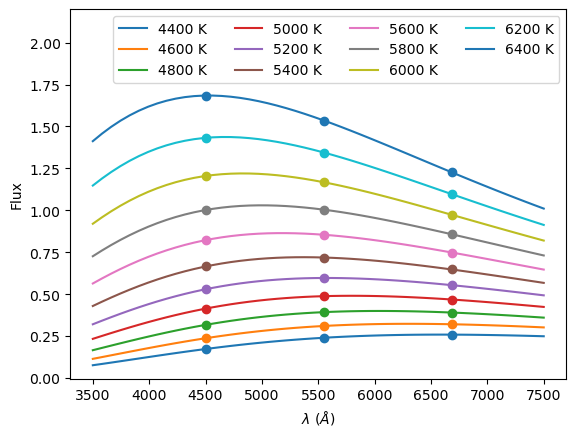

In [17]:
w = np.linspace(3500, 7500)
for T in np.arange(4400, 6600, 200):
    y = BB(w, T, 1)
    p = plt.plot(w, y, label=f"{T} K")
    plt.scatter(waves, BB(waves, T, 1), color=p[0].get_color())
plt.legend(ncol=4)
plt.xlabel("$\lambda$ ($\AA$)")
plt.ylabel("Flux")
plt.ylim(None, 2.2);

That's a quick look at expected flux versus wavelength

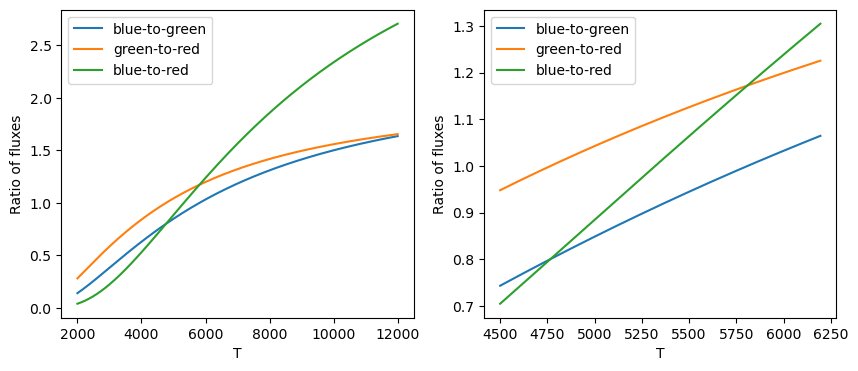

In [21]:
def plot_ratios(Ts):
    r12 = np.empty(Ts.shape)
    r23 = np.empty(Ts.shape)
    r31 = np.empty(Ts.shape)

    for i, T in enumerate(Ts):
        f1 = BB(waves[0], T, 1)
        f2 = BB(waves[1], T, 1)
        f3 = BB(waves[2], T, 1)
        r12[i] = f1 / f2
        r23[i] = f2 / f3
        r31[i] = f3 / f1

    plt.plot(Ts, r12, label="blue-to-green")
    plt.plot(Ts, r23, label="green-to-red")
    plt.plot(Ts, 1/r31, label="blue-to-red")
    plt.legend()
    plt.ylabel("Ratio of fluxes")
    plt.xlabel("T")

plt.figure(figsize=(10,4))
plt.subplot(121)
plot_ratios(np.arange(2000, 12000, 5, dtype=float))

plt.subplot(122)
plot_ratios(np.arange(4500, 6200, 5, dtype=float))

Green-to-red consistently produces more noisy temperature maps than the other two ratios, but it's ratio-to-temperature curve isn't significantly flatter than the others within the relevant range (and both colors, each in combination with blue, produce much better maps). Not sure what's up.

# Producing temperature maps

2008-02-02T18:03:55.842
2008-02-02T18:04:05.425
2008-02-02T18:04:15.017


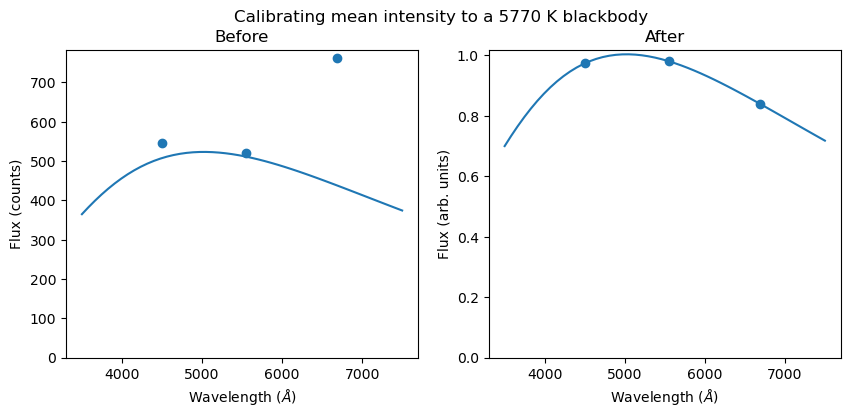

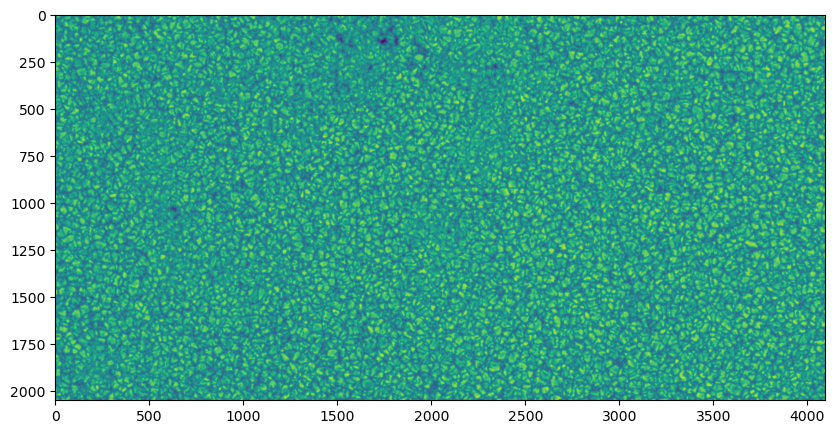

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


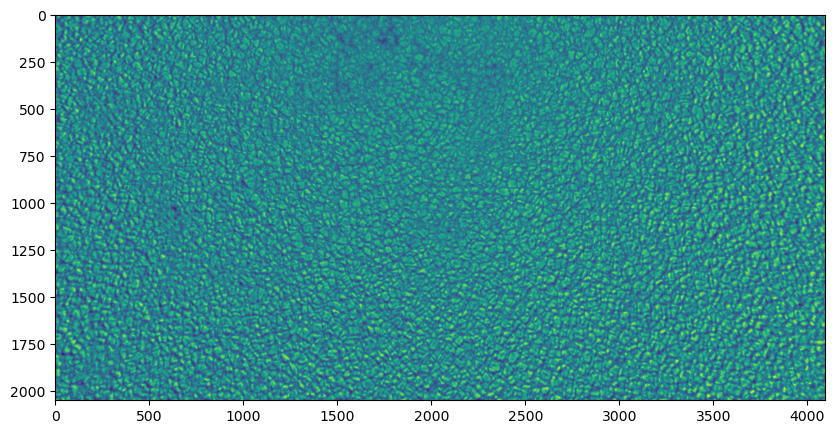

Aligning...
Done
Translations: (15.581, 0.305), (8.996, 0.011)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


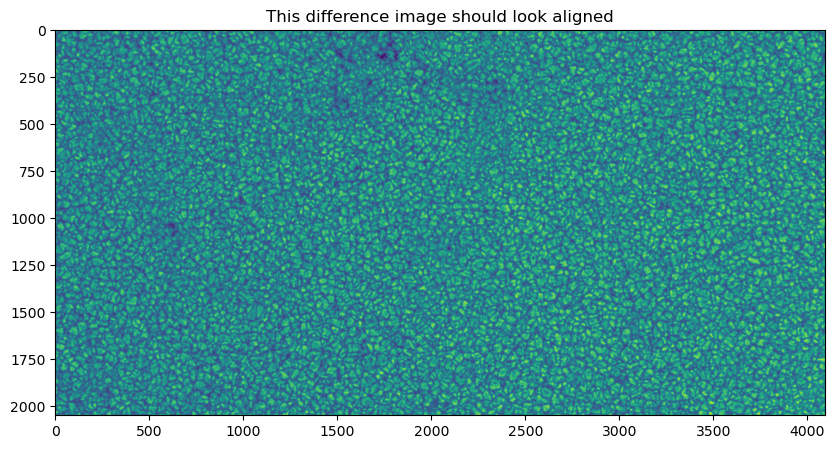

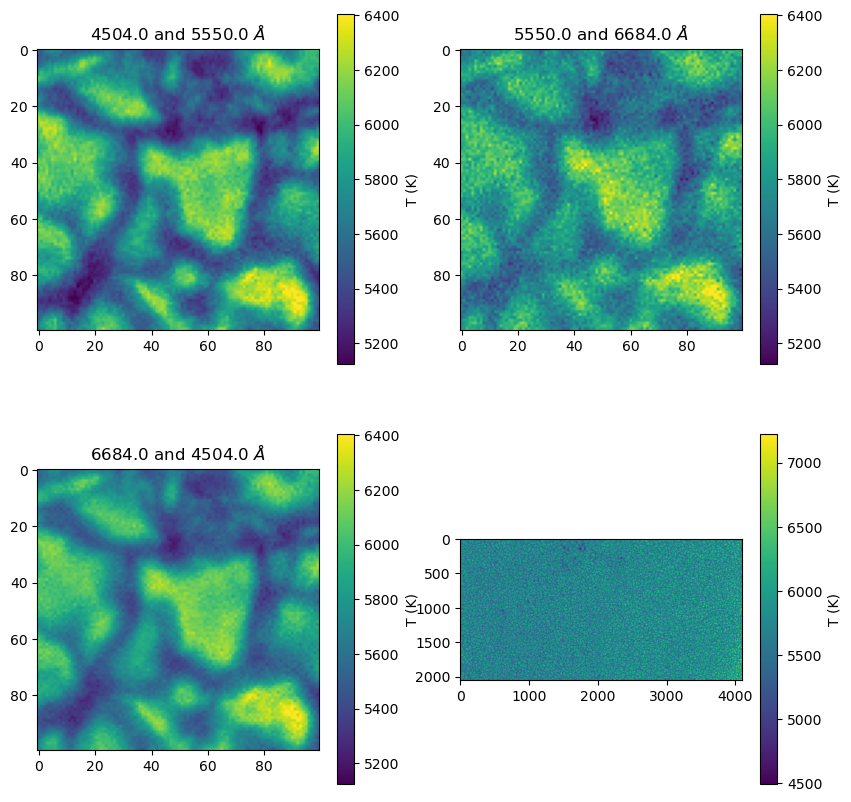

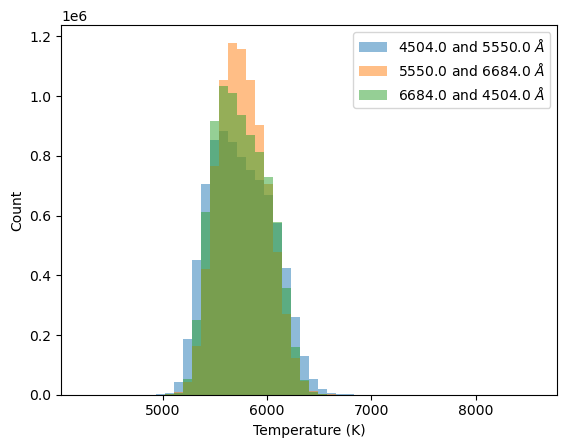

Theta12:  0.050432621383615366
Theta23:  0.0392821141642016
Theta31:  0.042929195207791225
Theta mean:  0.042198016159352966


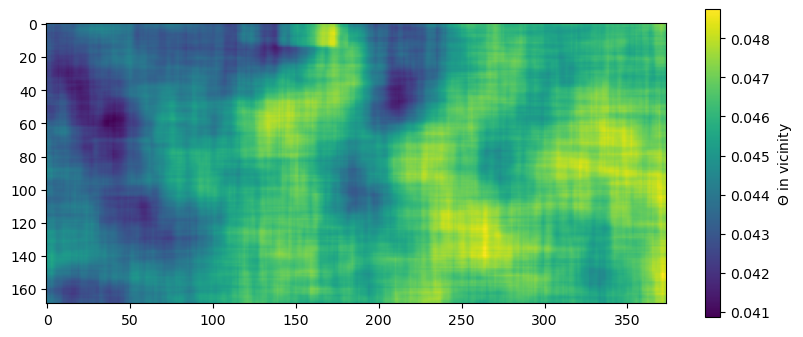

In [30]:
match_pattern = '2008-02-02'
data, headers, waves, tmaps, tmap_mean = process(match_pattern, align_override=bf_align, save_tmaps=False)

Sit back for a bulk run of all our selected observations:

2008-01-04T11:06:26.648
2008-01-04T11:06:36.217
2008-01-04T11:06:45.808


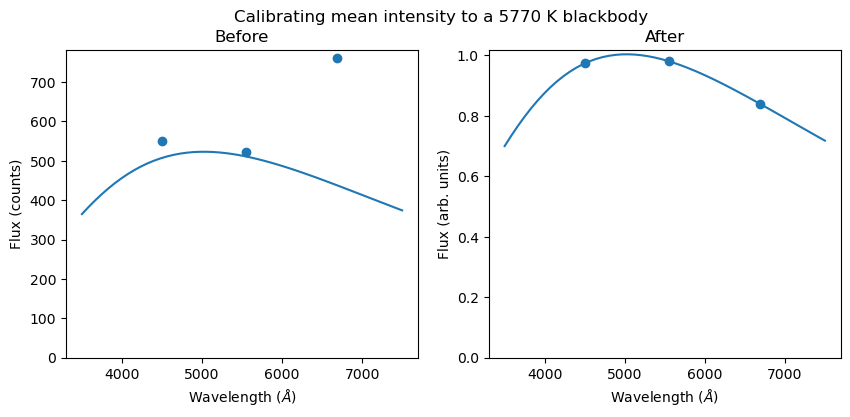

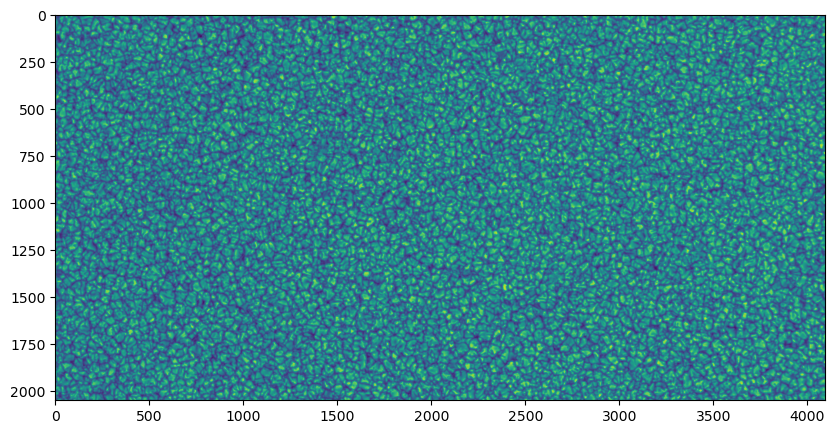

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


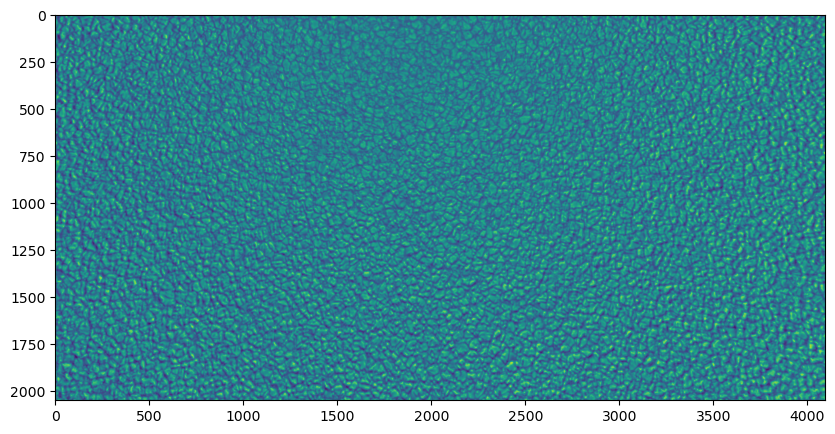

Aligning...
Done
Translations: (14.969, 0.000), (8.872, 0.015)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


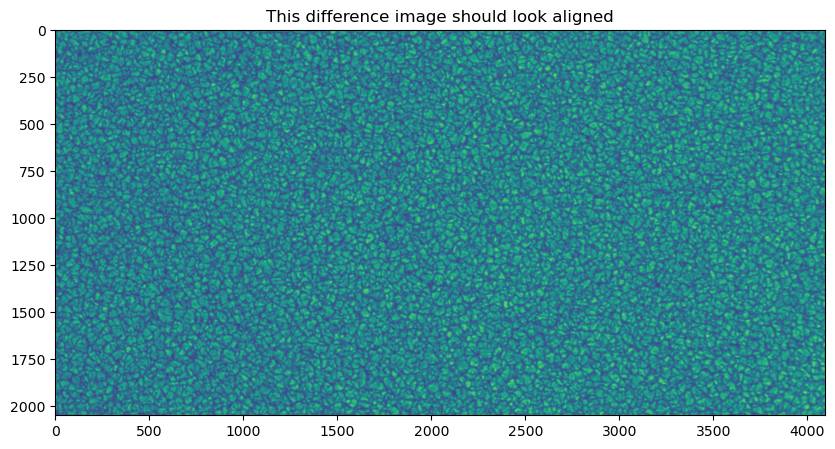

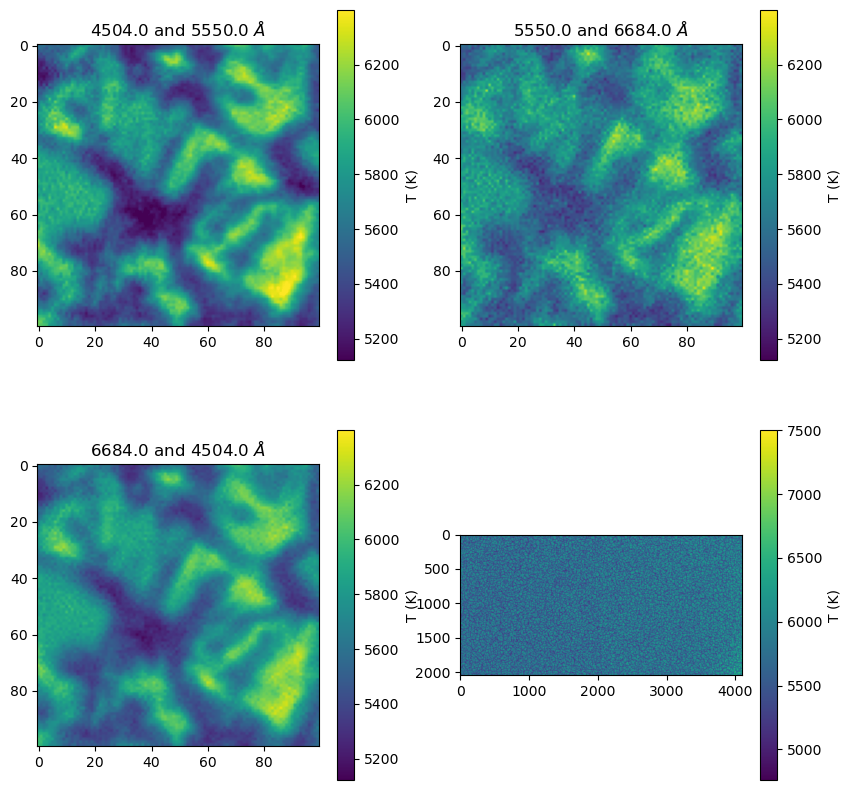

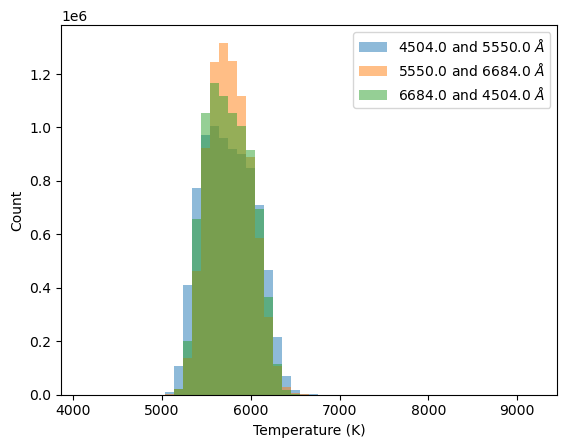

Theta12:  0.049401043834372424
Theta23:  0.040123399982759045
Theta31:  0.0429940242814522
Theta mean:  0.042375662541485844


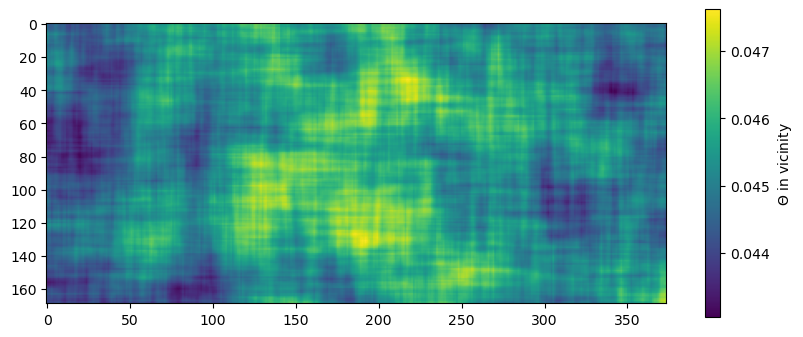

2008-01-05T00:00:27.753
2008-01-05T00:00:37.338
2008-01-05T00:00:46.926


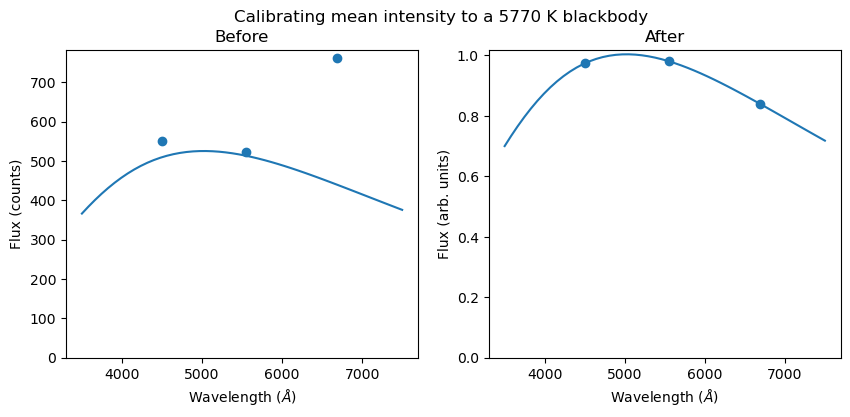

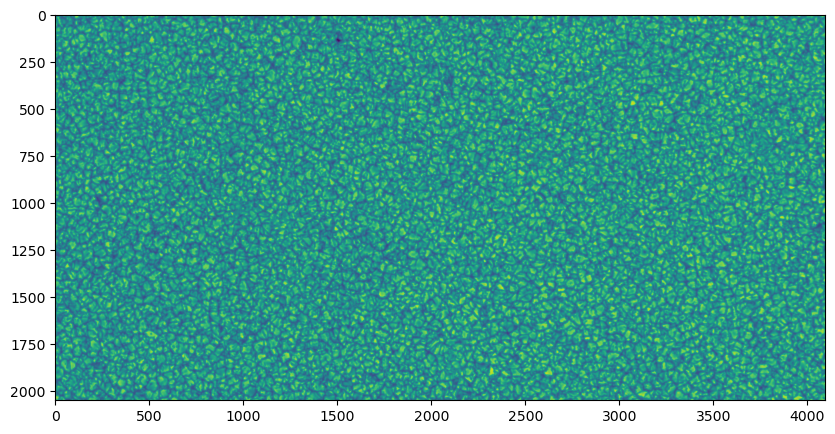

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


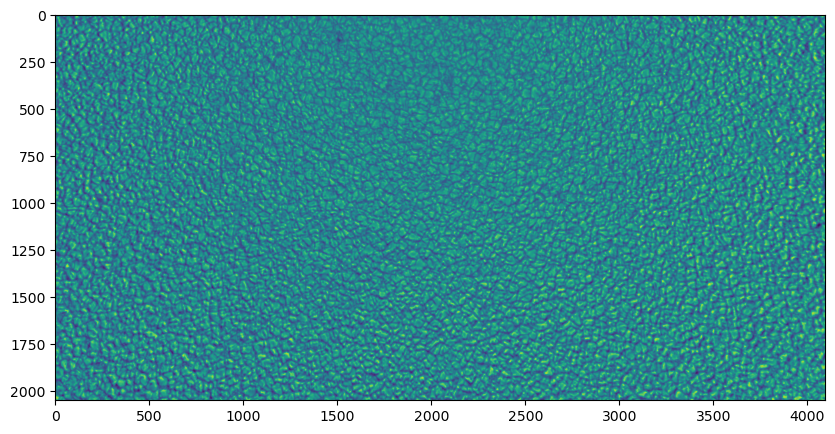

Aligning...
Done
Translations: (15.608, 0.616), (9.023, 0.024)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


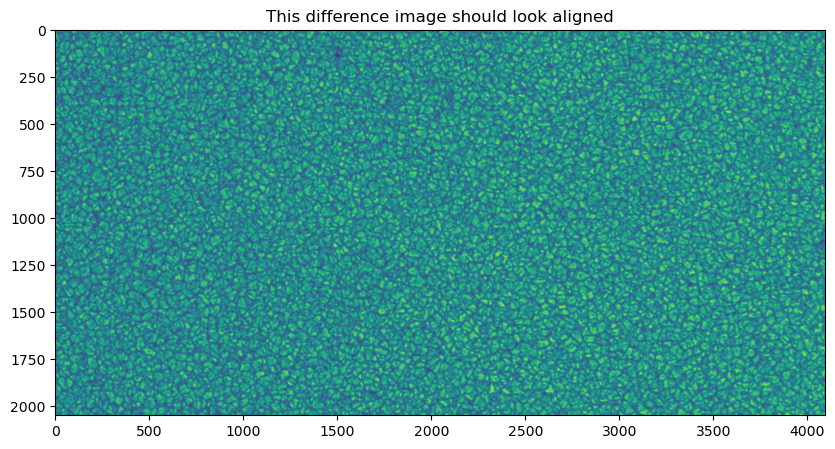

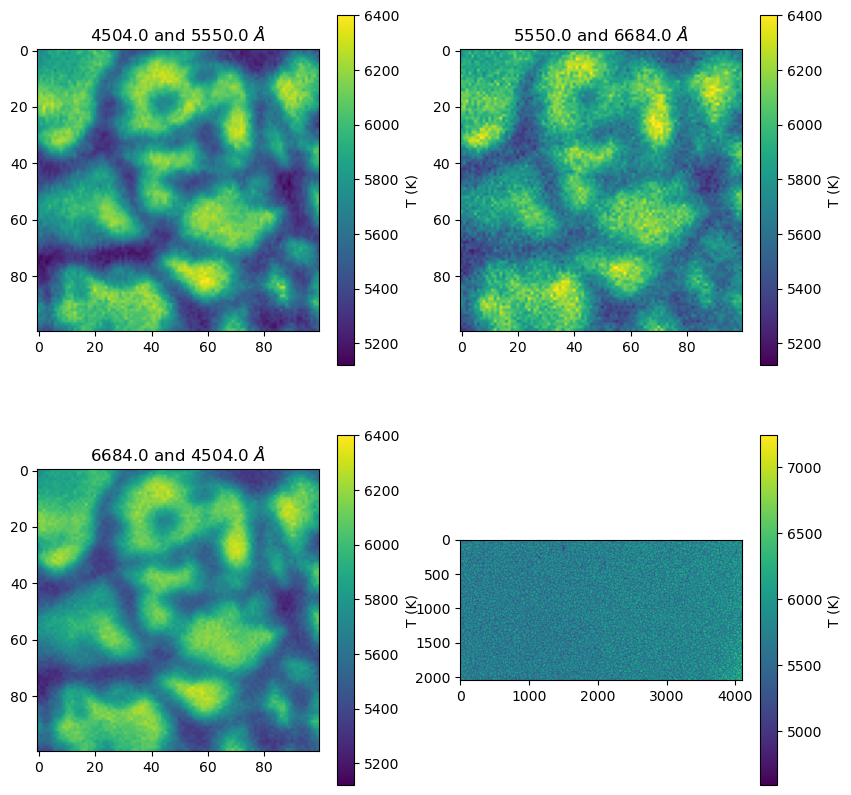

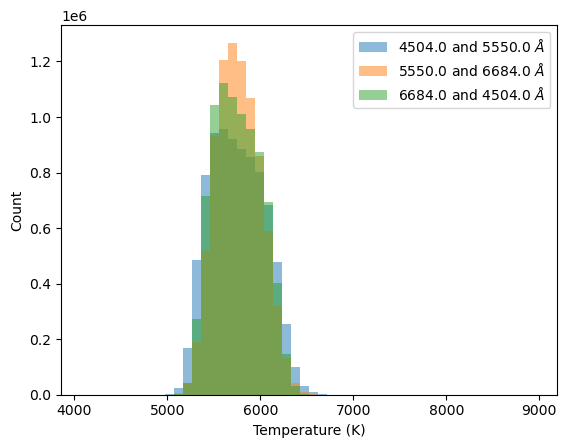

Theta12:  0.049645262089561604
Theta23:  0.04024926989351994
Theta31:  0.042982063849889646
Theta mean:  0.042354052583356984


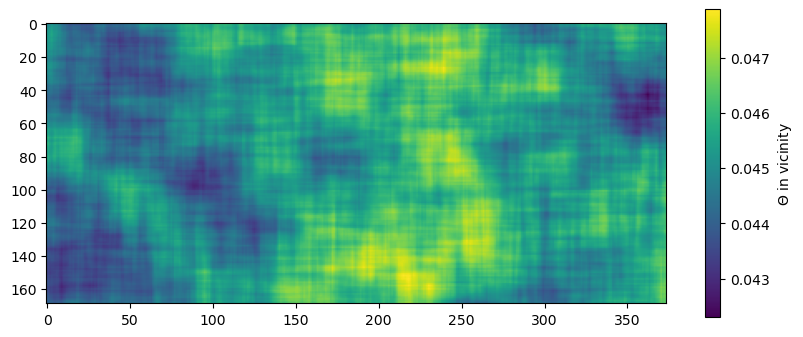

2008-01-08T06:13:25.742
2008-01-08T06:13:35.329
2008-01-08T06:13:44.909


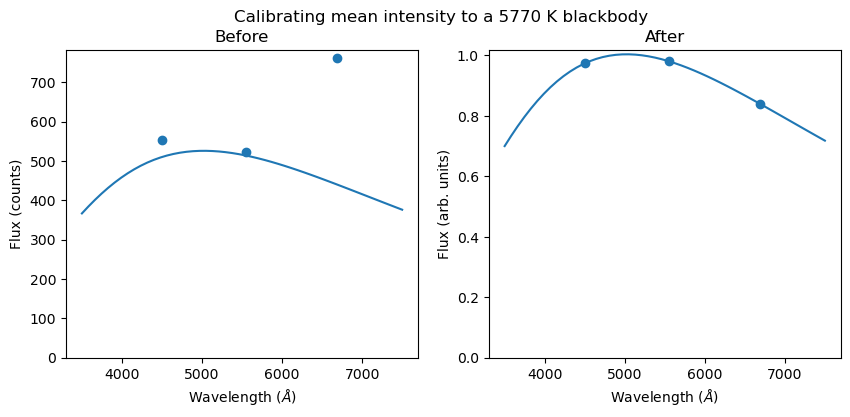

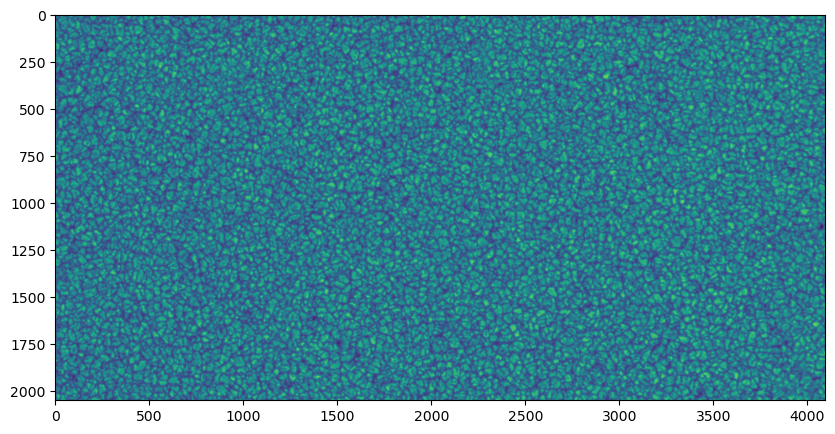

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


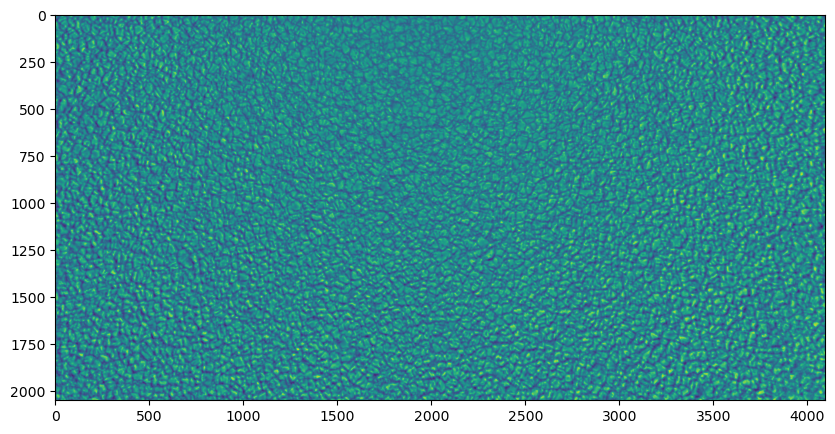

Aligning...
Done
Translations: (15.552, 0.071), (9.022, 0.017)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


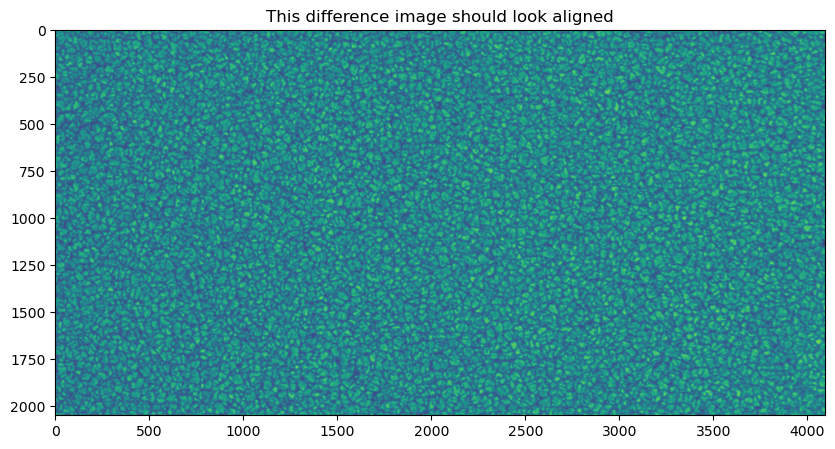

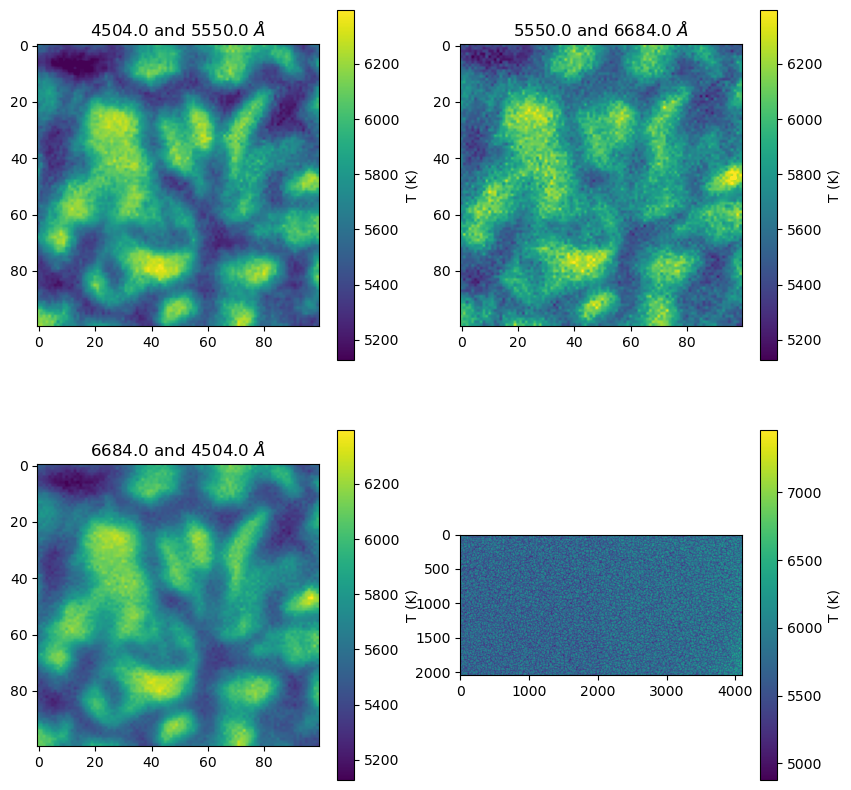

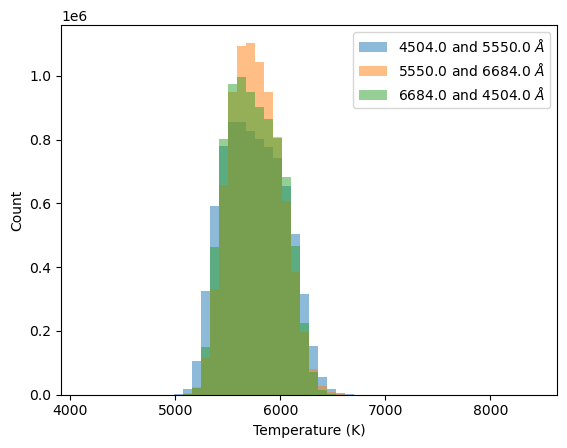

Theta12:  0.04881163759069131
Theta23:  0.04042016107332601
Theta31:  0.04254074272171981
Theta mean:  0.04196859898845843


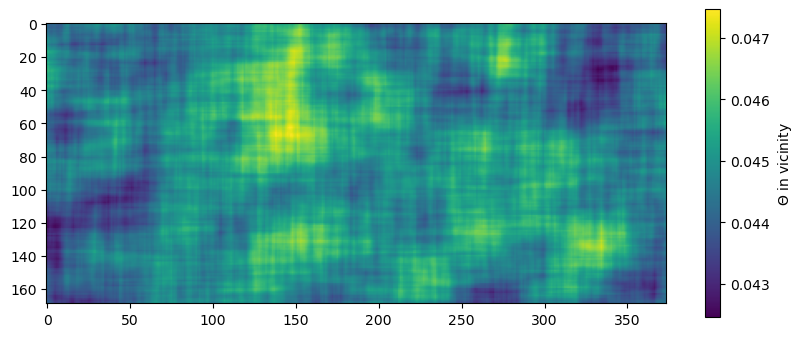

2008-02-02T18:03:55.842
2008-02-02T18:04:05.425
2008-02-02T18:04:15.017


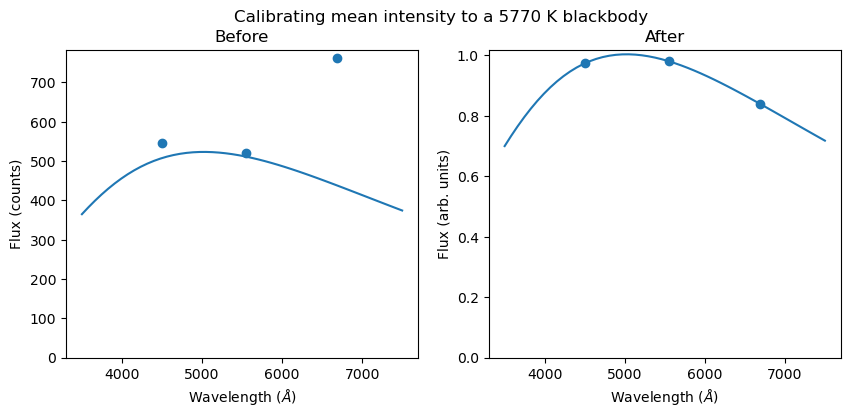

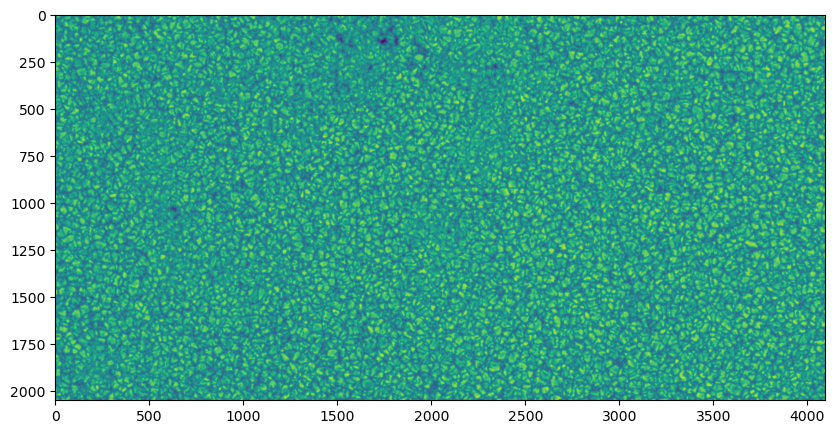

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


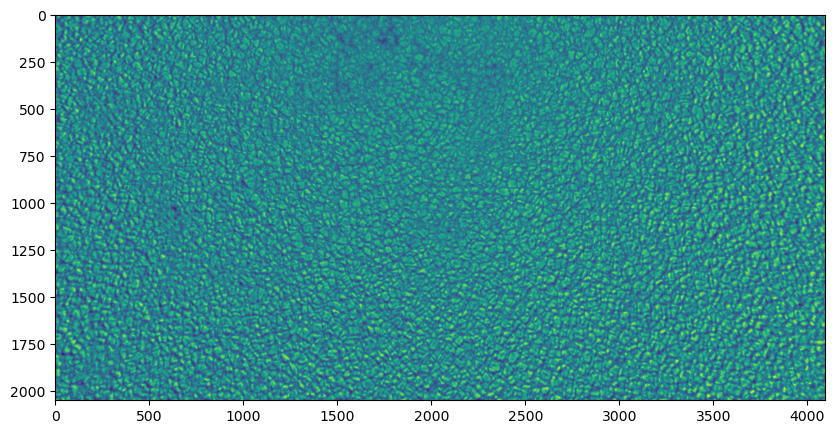

Aligning...
Done
Translations: (15.581, 0.305), (8.996, 0.011)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


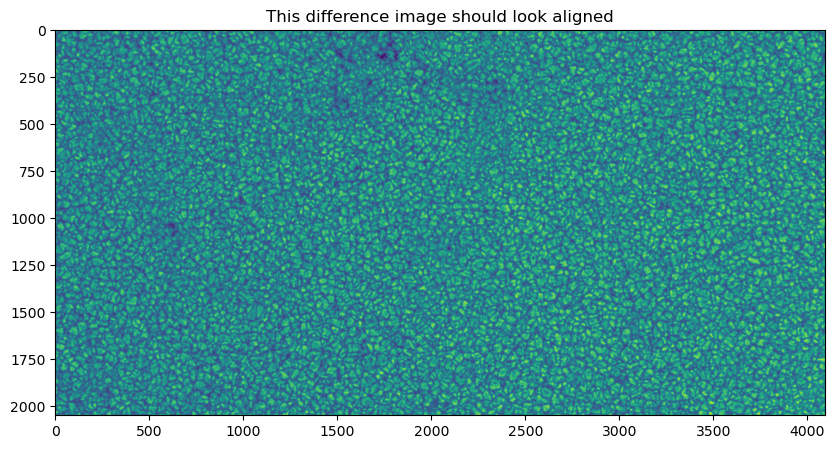

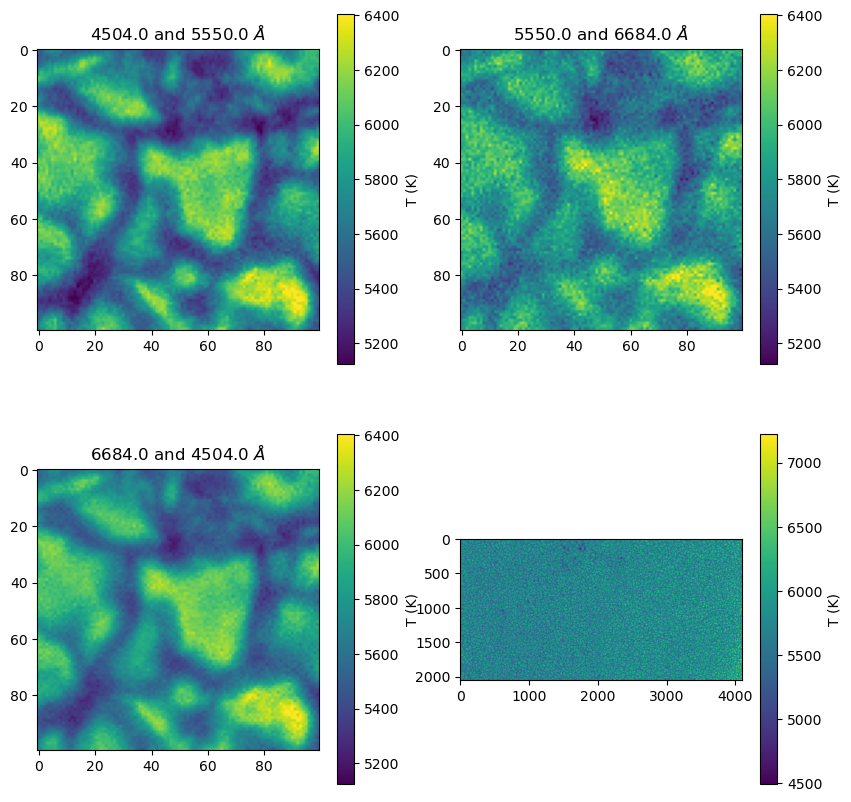

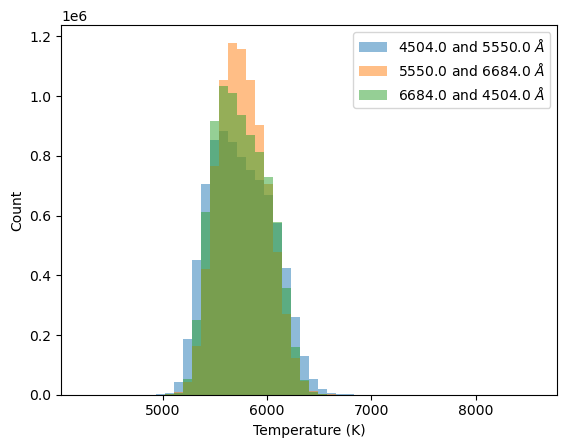

Theta12:  0.050432621383615366
Theta23:  0.0392821141642016
Theta31:  0.042929195207791225
Theta mean:  0.042198016159352966


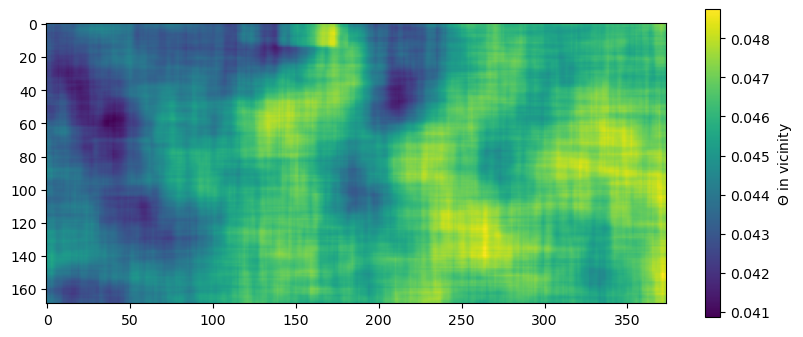

2008-02-03T18:09:03.844
2008-02-03T18:09:23.007
2008-02-03T18:09:43.774


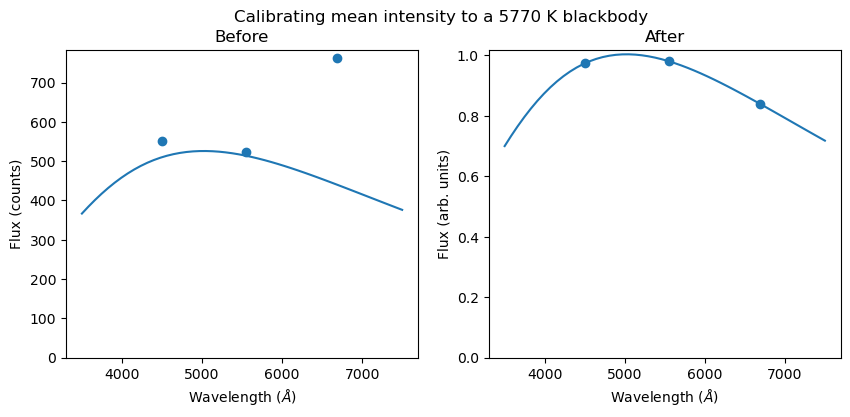

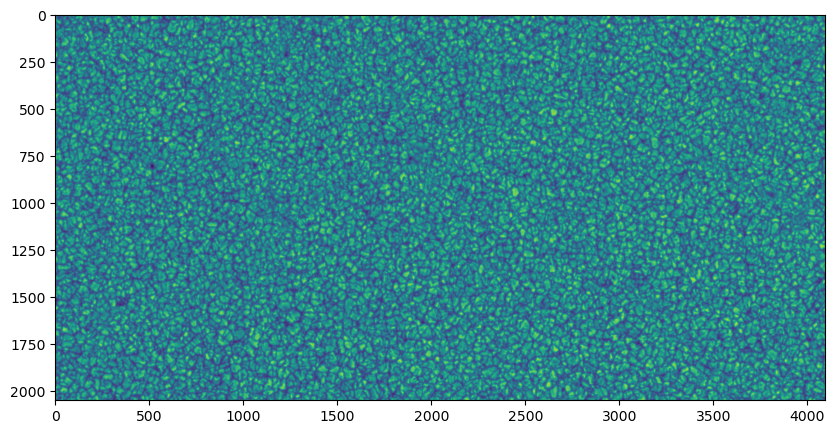

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


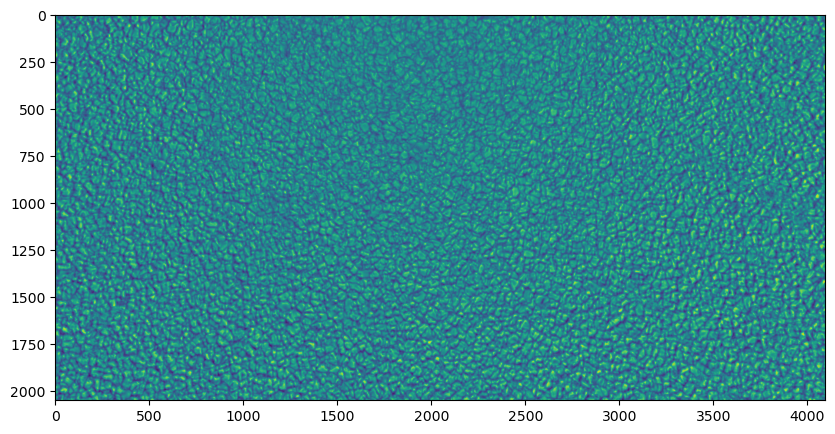

Aligning...
Done
Translations: (15.175, 0.006), (8.636, 0.000)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


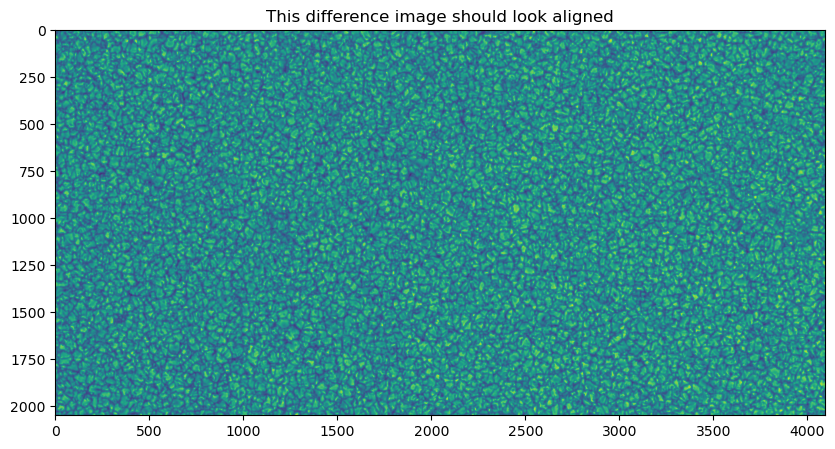

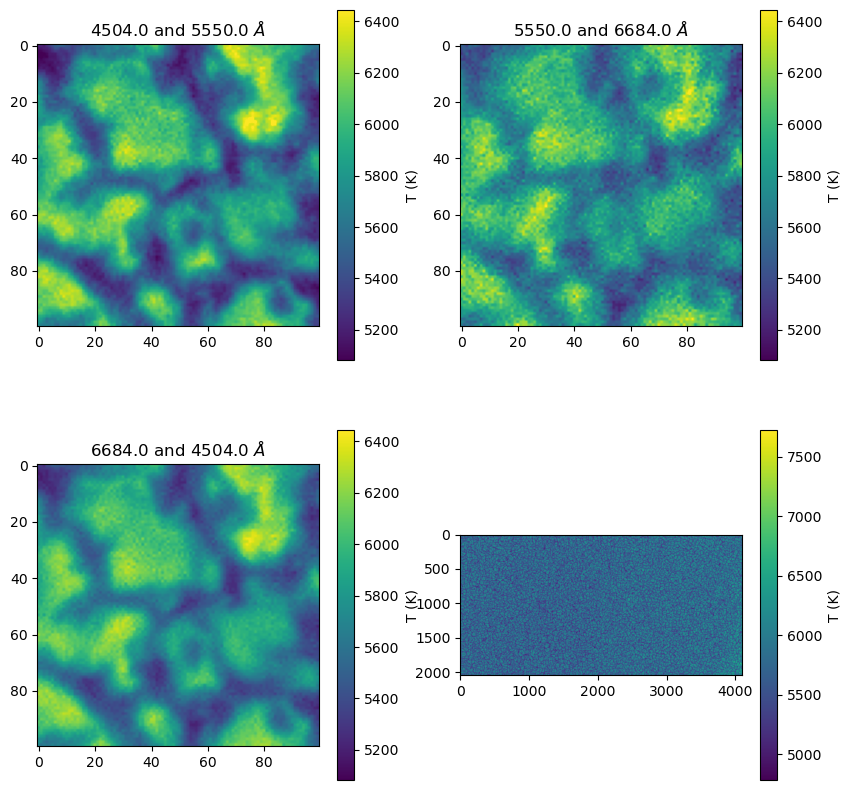

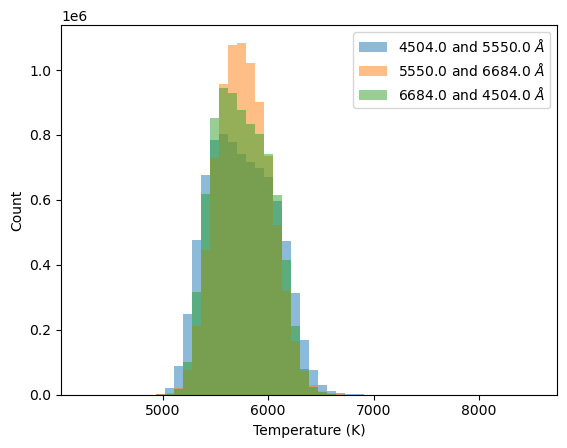

Theta12:  0.053417093741301054
Theta23:  0.04206988370395869
Theta31:  0.04557790451350763
Theta mean:  0.04481786599549878


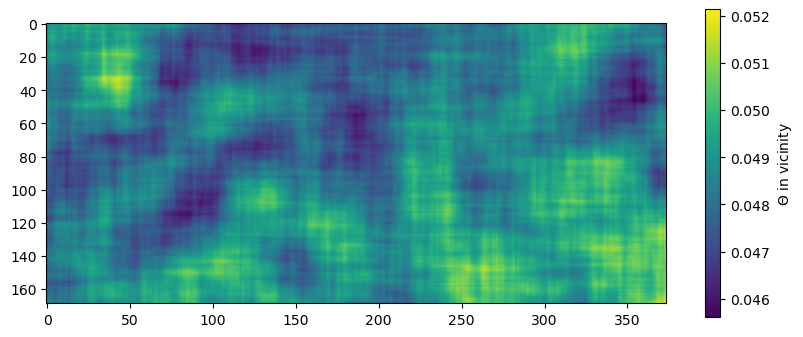

2008-02-04T18:27:57.703
2008-02-04T18:28:07.287
2008-02-04T18:28:16.869


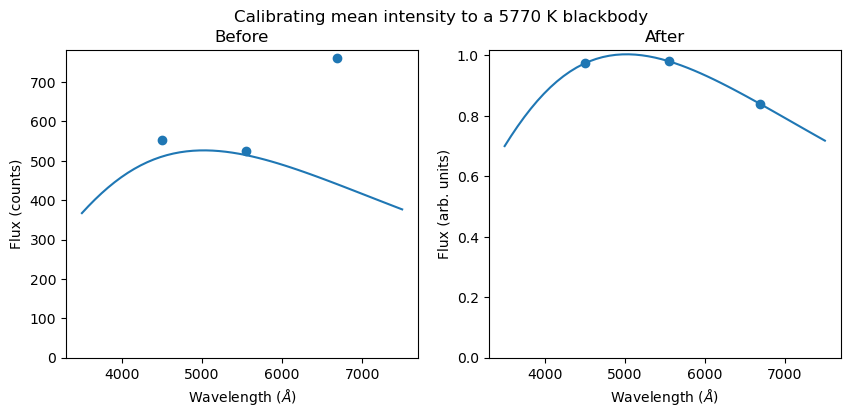

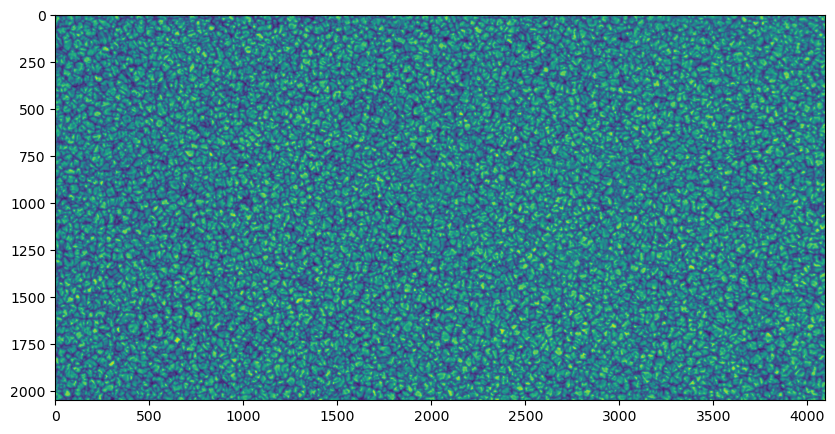

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


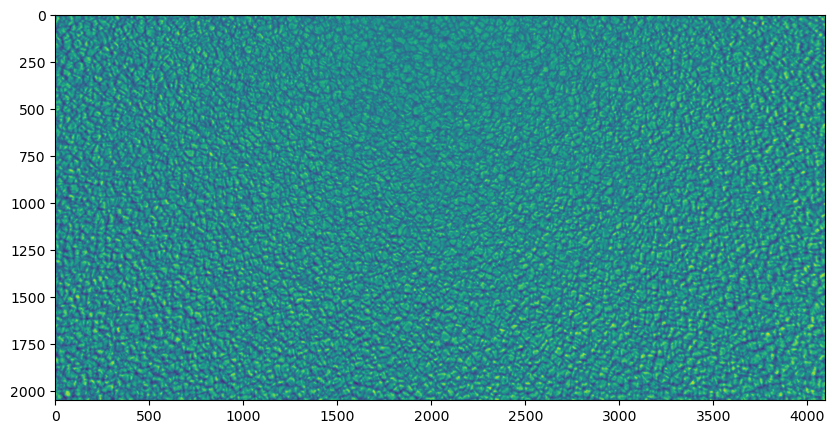

Aligning...
Done
Translations: (15.630, 0.222), (8.973, 0.015)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


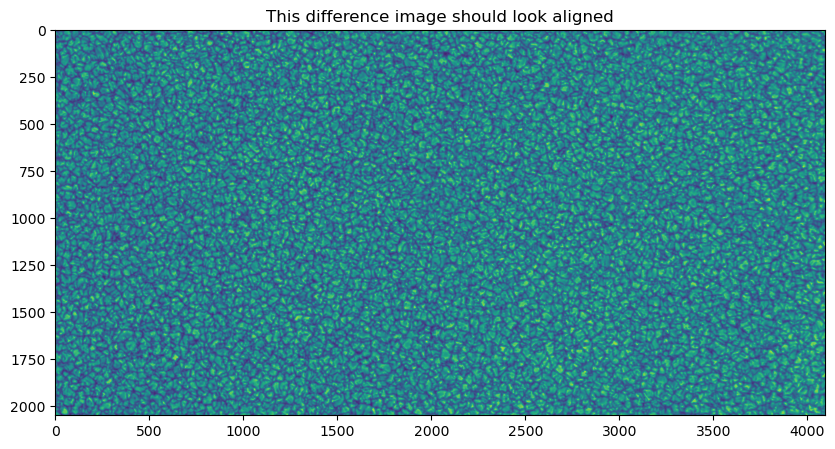

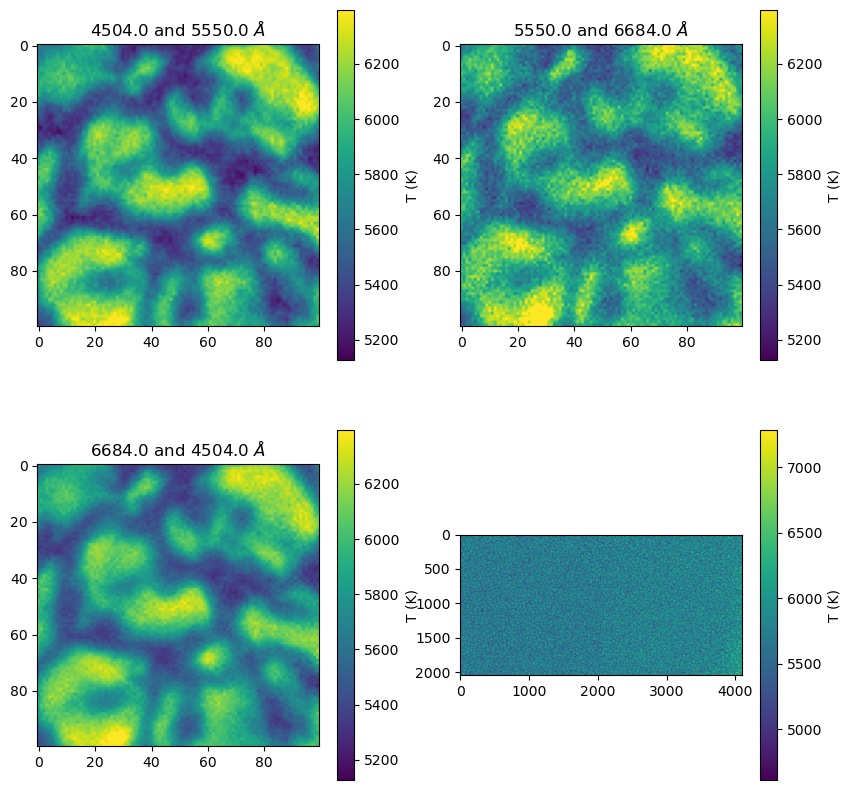

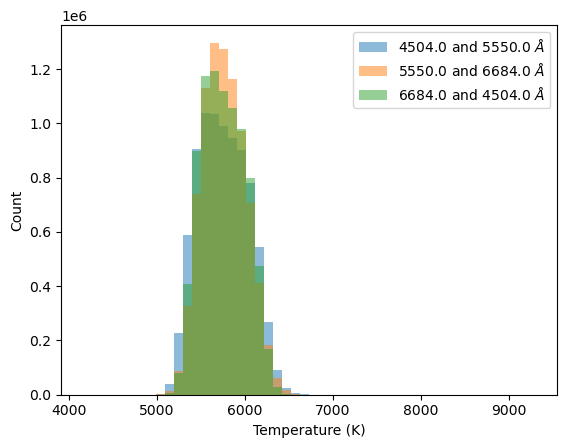

Theta12:  0.0481836631741086
Theta23:  0.04148403246539246
Theta31:  0.04224910370170457
Theta mean:  0.041767096589320284


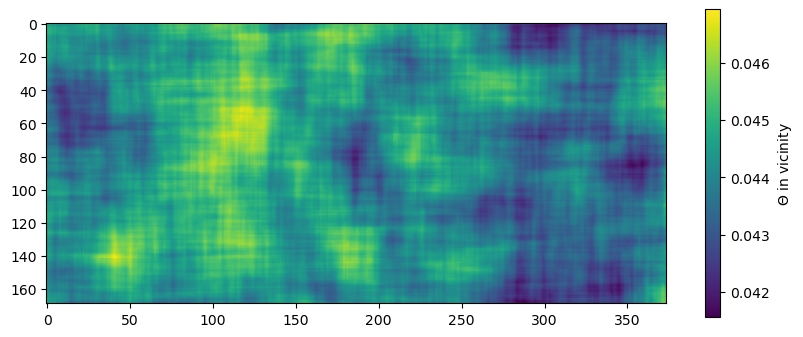

2008-02-05T05:58:57.909
2008-02-05T05:59:07.495
2008-02-05T05:59:17.085


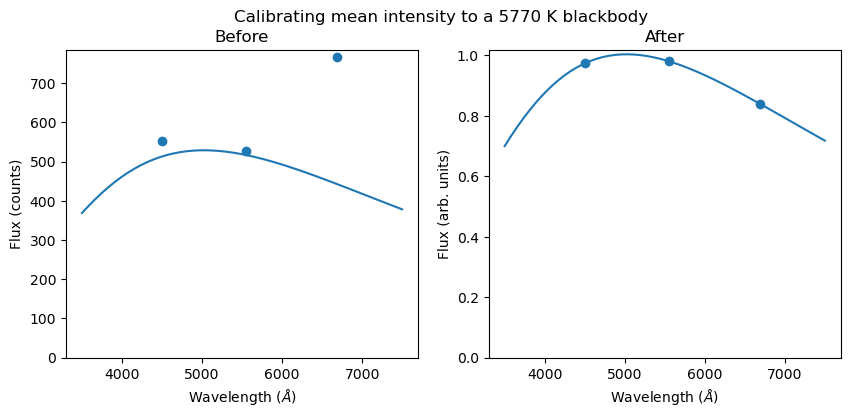

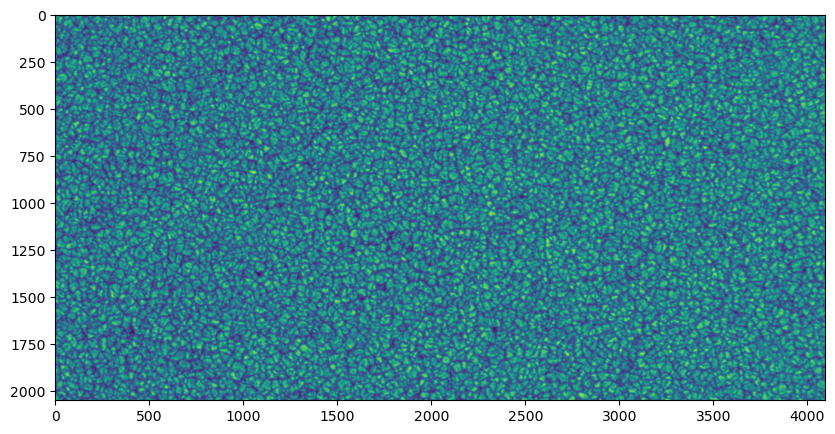

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


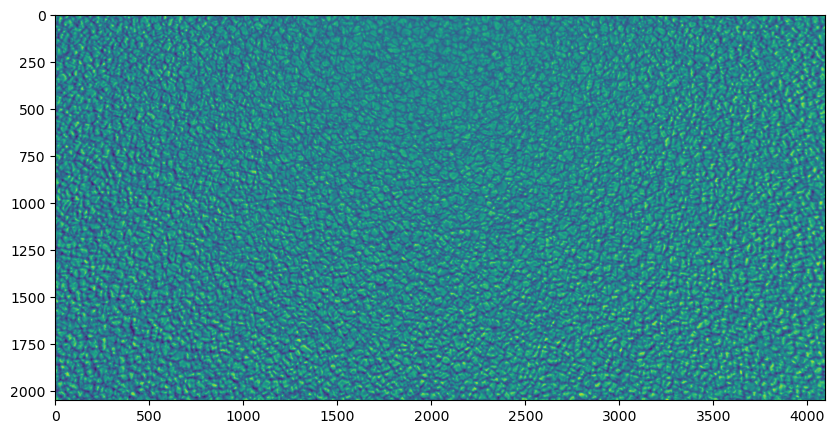

Aligning...
Done
Translations: (16.009, 0.615), (8.976, 0.008)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


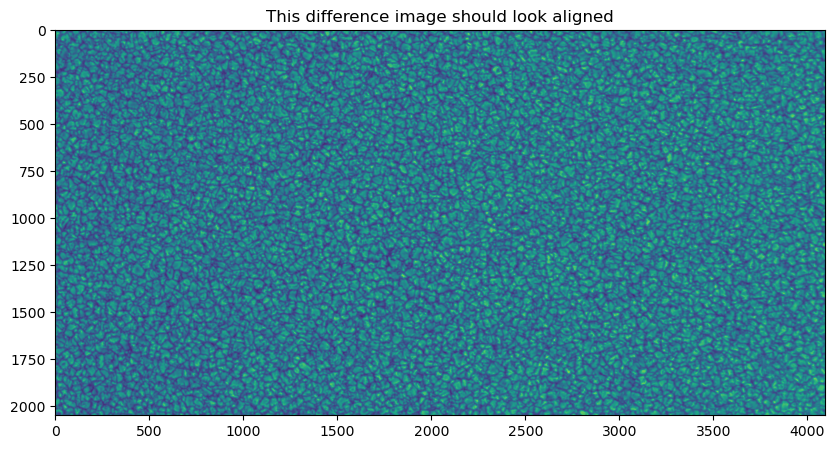

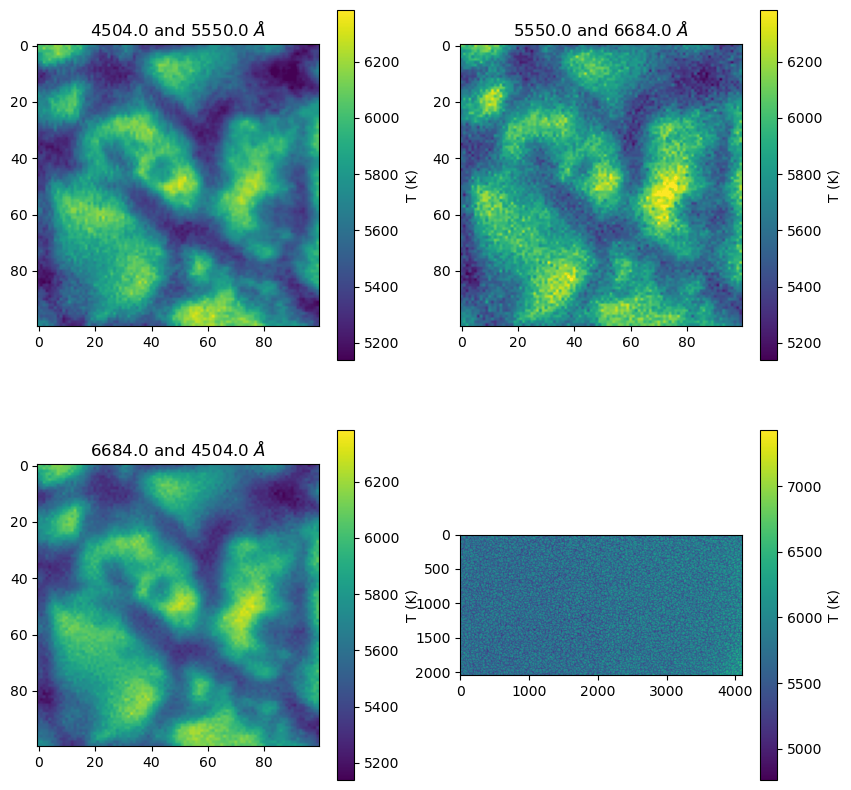

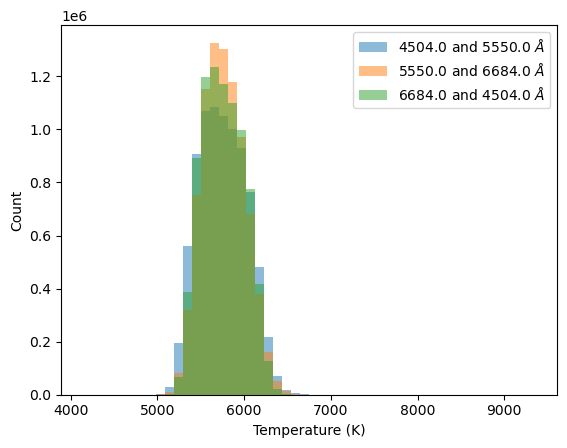

Theta12:  0.046877548462031834
Theta23:  0.041206901153799554
Theta31:  0.04142800596377117
Theta mean:  0.04101772322688702


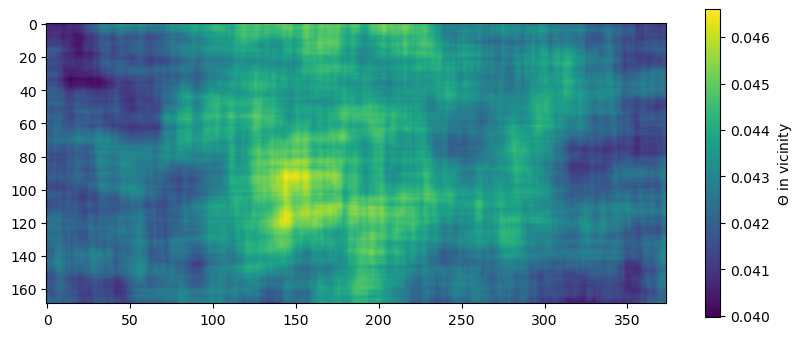

2008-02-05T10:37:57.588
2008-02-05T10:38:07.175
2008-02-05T10:38:16.764


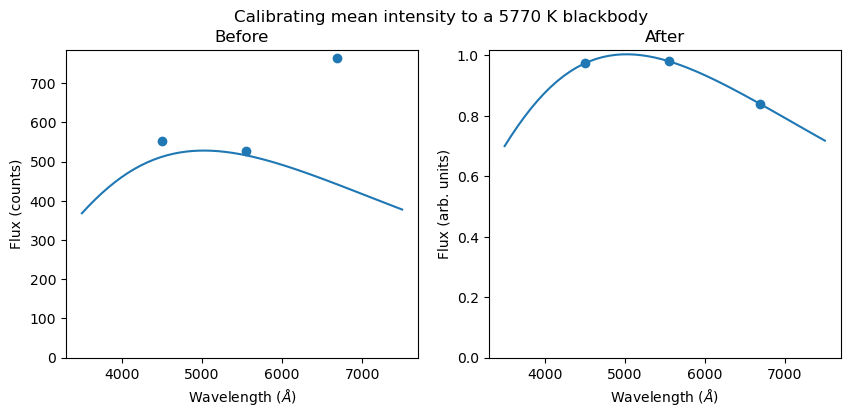

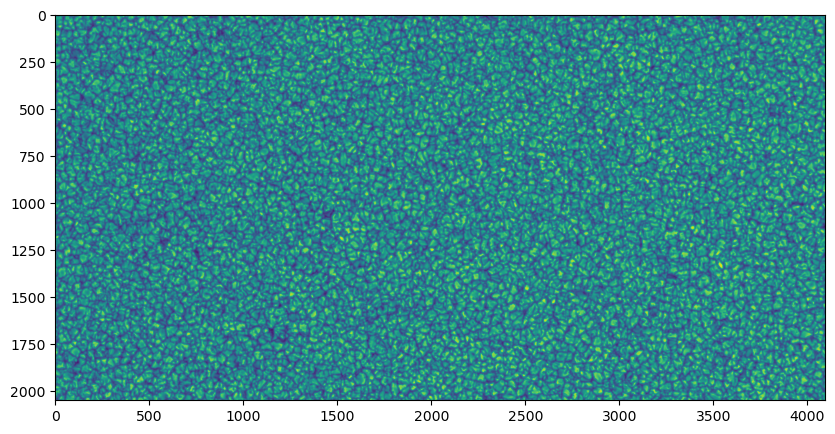

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


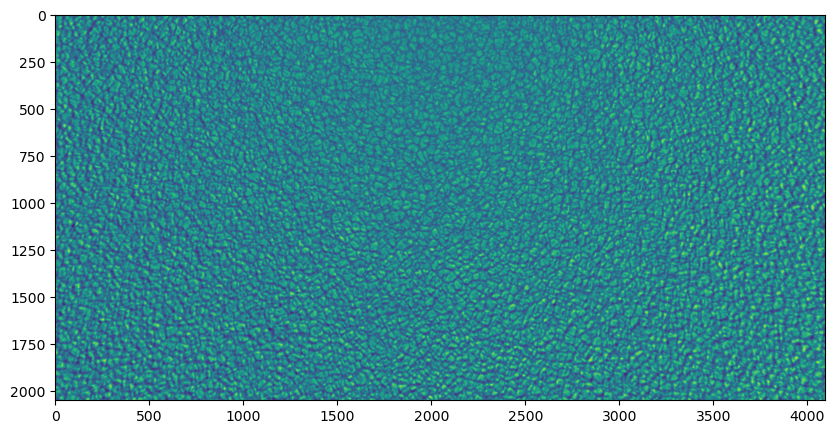

Aligning...
Done
Translations: (15.555, 0.397), (9.039, -0.000)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


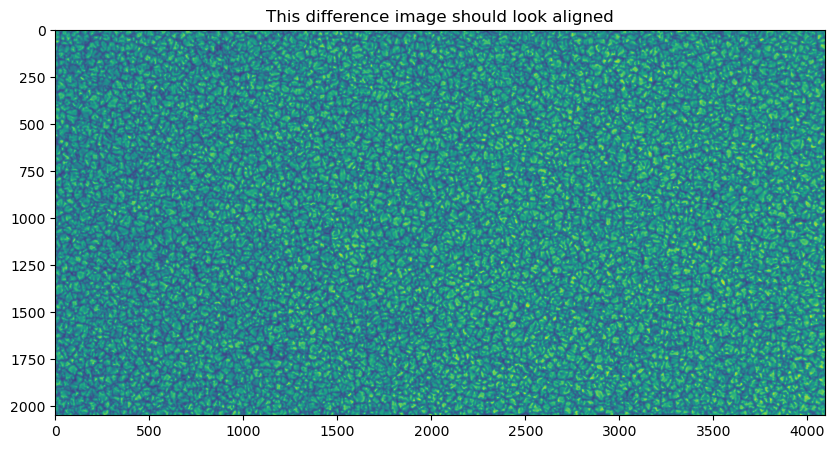

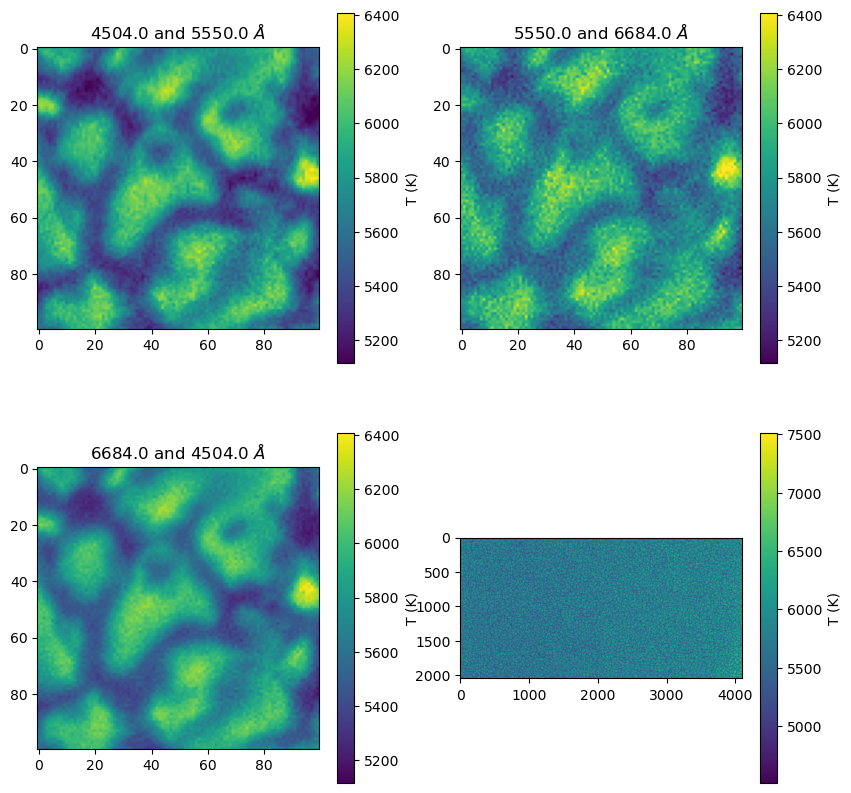

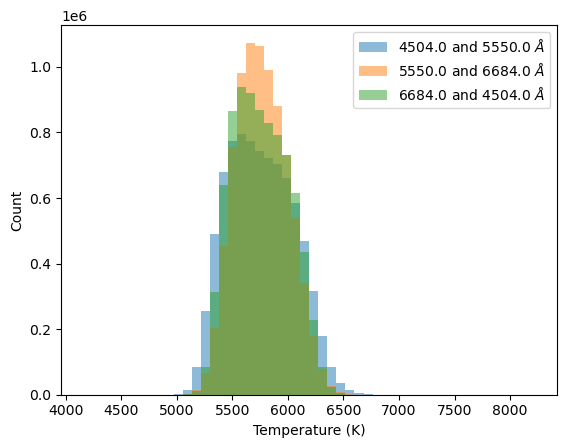

Theta12:  0.05081291227680166
Theta23:  0.03986620900058729
Theta31:  0.04319449289374215
Theta mean:  0.04246296314866246


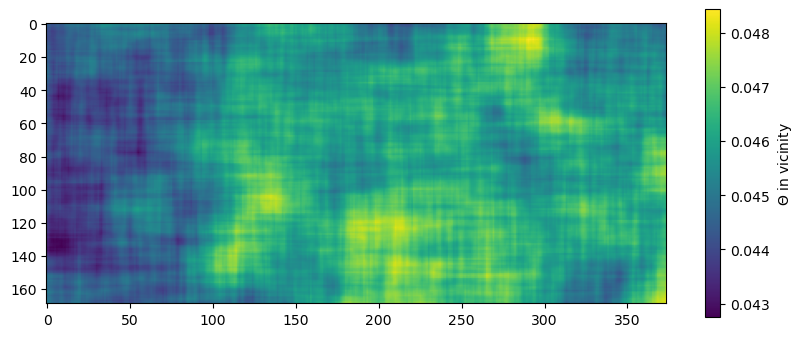

2008-02-06T00:02:27.732
2008-02-06T00:02:37.307
2008-02-06T00:02:46.895


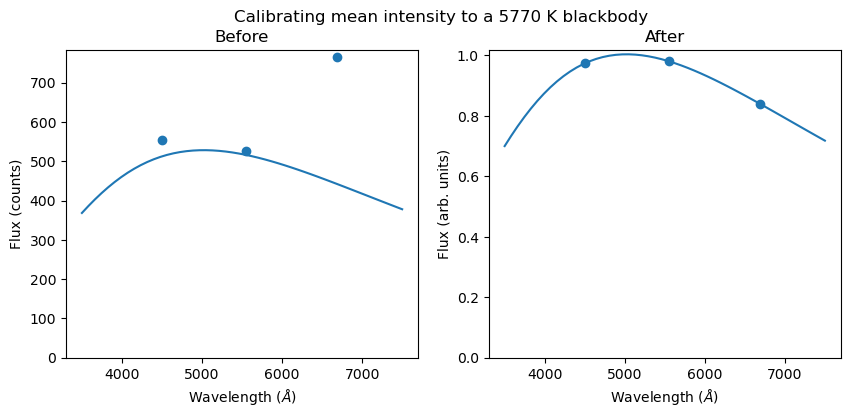

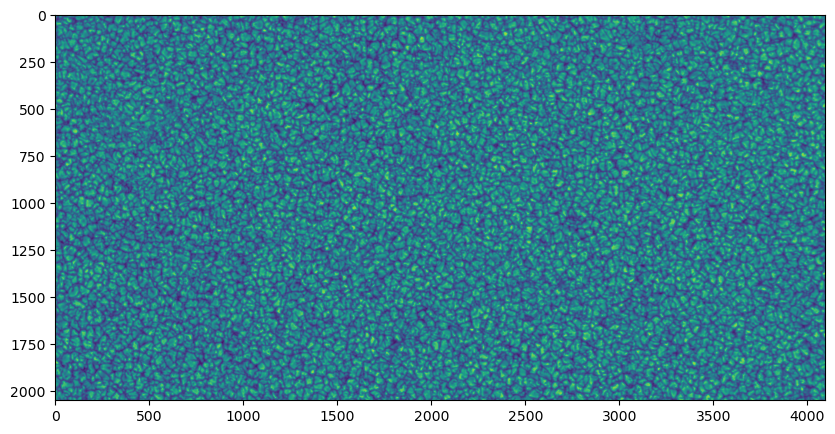

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


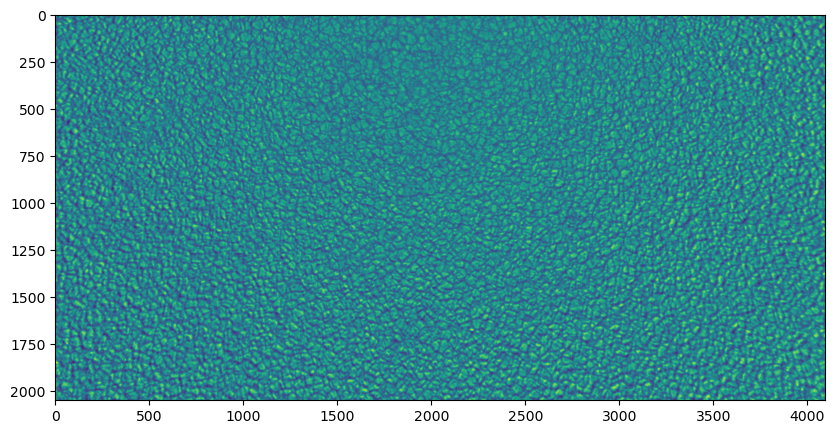

Aligning...
Done
Translations: (15.883, 0.559), (8.956, 0.011)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


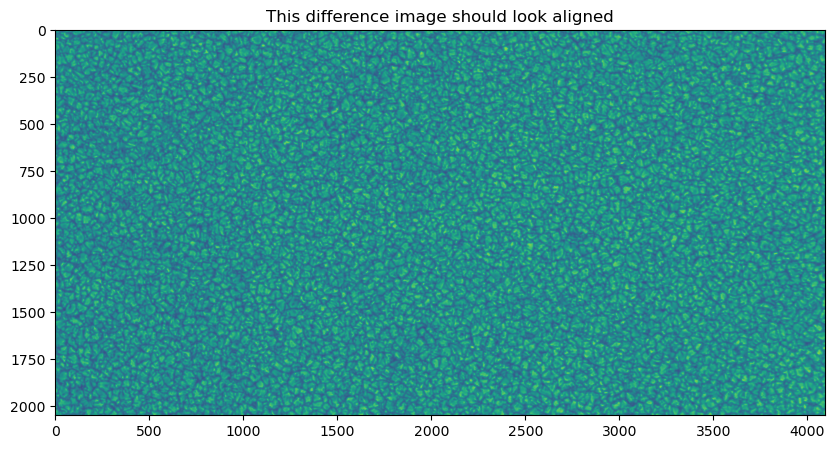

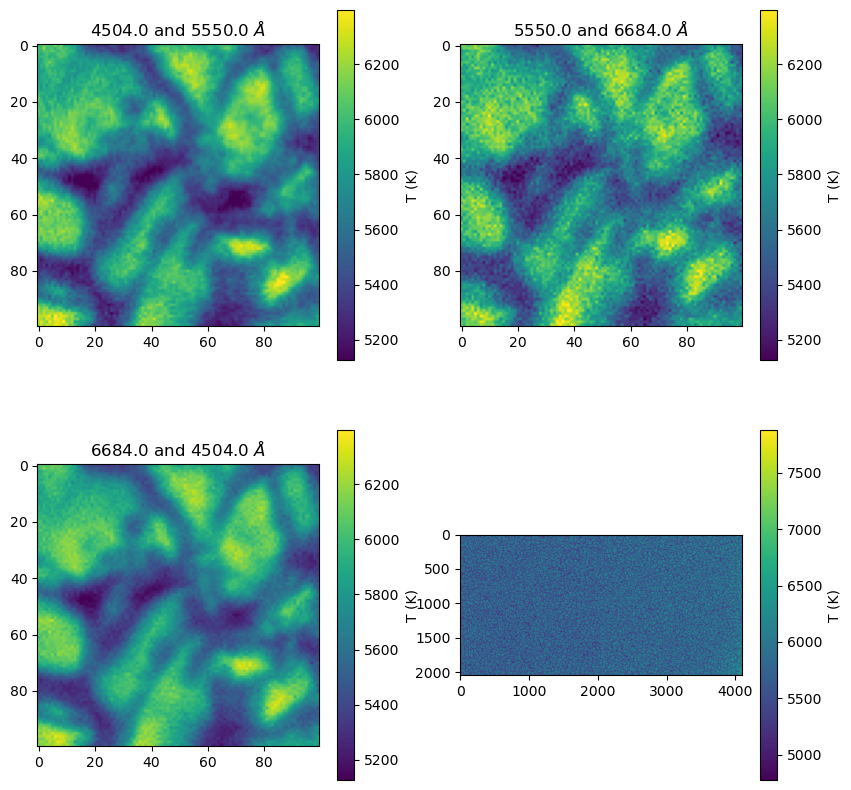

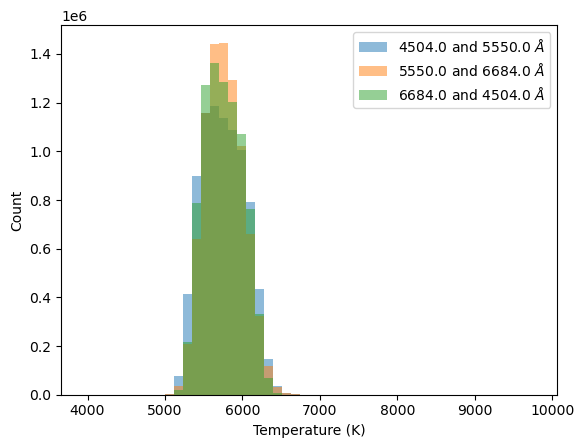

Theta12:  0.04761727906035711
Theta23:  0.04214070831615979
Theta31:  0.042145206627298454
Theta mean:  0.041737907527147344


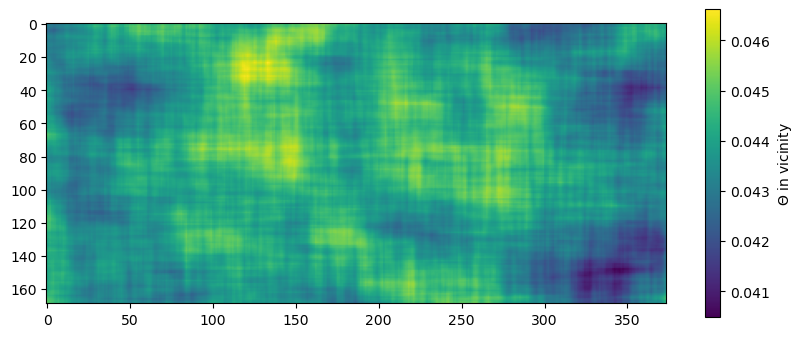

2008-02-06T10:58:27.285
2008-02-06T10:58:36.872
2008-02-06T10:58:46.462


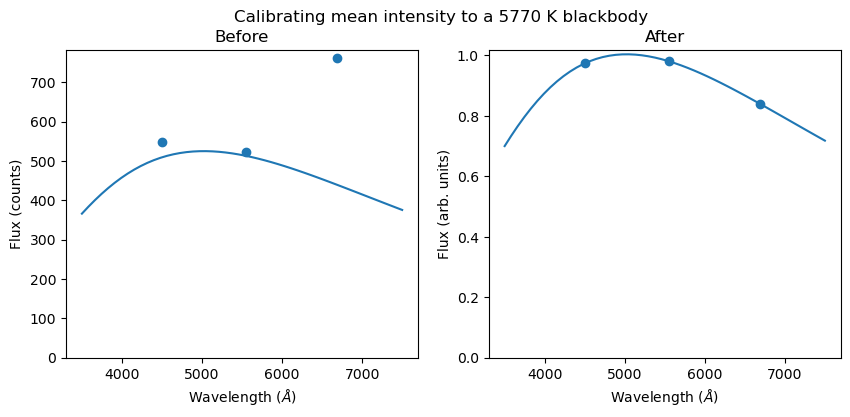

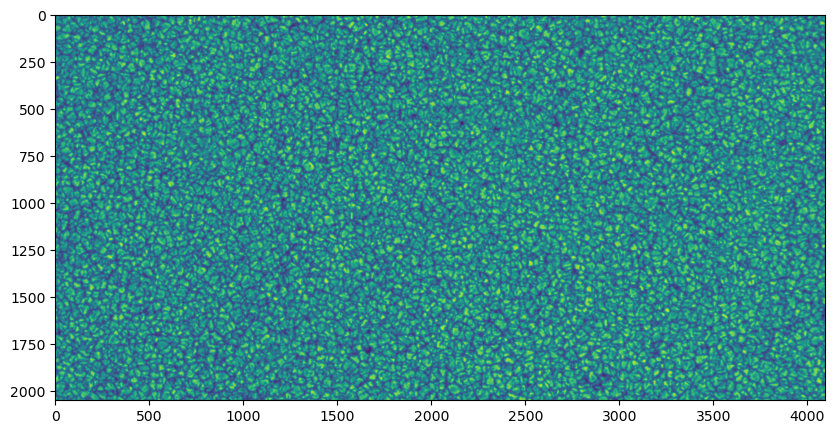

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


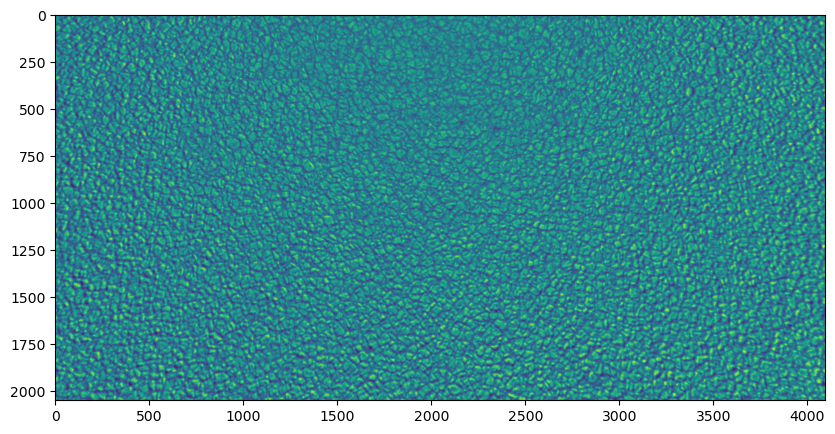

Aligning...
Done
Translations: (15.623, 0.247), (8.913, 0.003)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


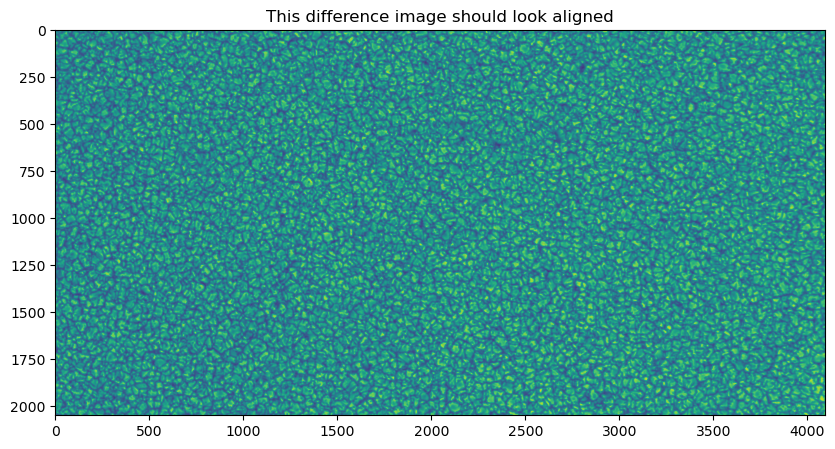

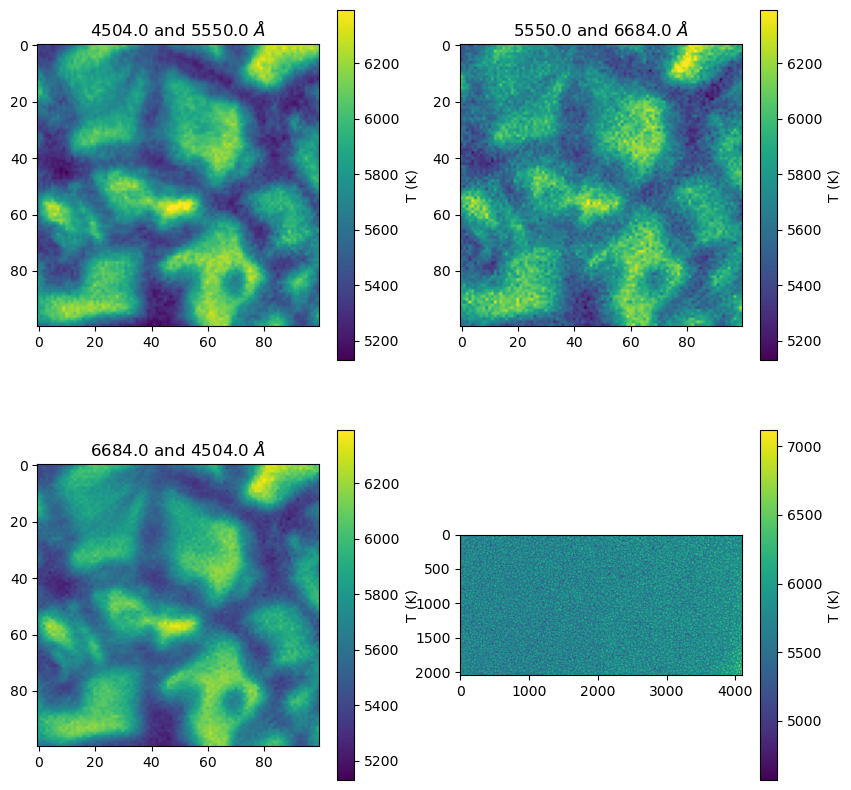

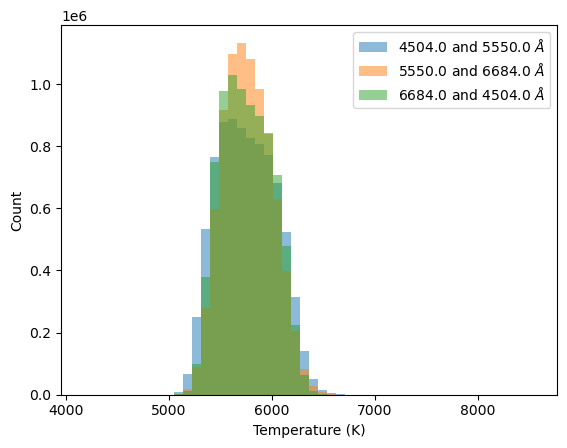

Theta12:  0.04817153514927582
Theta23:  0.04052413076390584
Theta31:  0.04216411767567407
Theta mean:  0.041636160690327


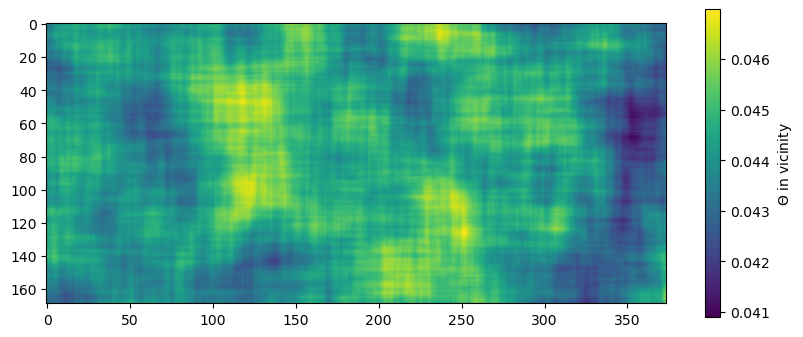

In [17]:
for match_pattern in ['2008-01-04', '2008-01-05', '2008-01-08', '2008-02-02', '2008-02-03',
                      '2008-02-04', '2008-02-05T05', '2008-02-05T10', '2008-02-06T00', '2008-02-06T10']:
    process(match_pattern, align_override=bf_align)

## The effect of downscaling

From a few spot checks, 2x2 binning reduces Theta by about 5%

2008-02-02T18:03:55.842
2008-02-02T18:04:05.425
2008-02-02T18:04:15.017
Aligning...
Scale factors: 0.99198, 0.99613
(Nominal: 0.99218, 0.99641)
Translations: (7.924, 0.194), (4.442, 0.000)
(Normal is about (15.4, 0), (9, 0))
Theta12:  0.048290858952767336
Theta23:  0.034983157866399765
Theta31:  0.04124314076752117
Theta mean:  0.04043031295342305


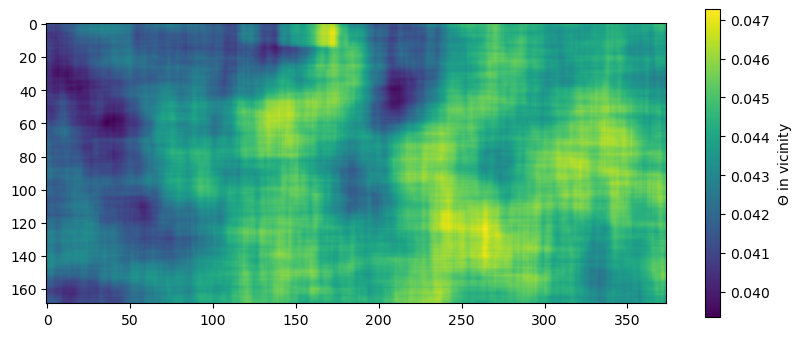

In [44]:
match_pattern = '2008-02-02'
data_2x2, headers, waves, tmaps, tmap_mean = process(match_pattern, ds=2, save_tmaps=False, show_plots=False)
plot_theta_in_vicinity(np.mean([tmaps[0], tmaps[2]], axis=0), window_size=350//2, stride=10//2)

2008-02-02T18:03:55.842
2008-02-02T18:04:05.425
2008-02-02T18:04:15.017
Aligning...
Scale factors: 0.99220, 0.99606
(Nominal: 0.99218, 0.99641)
Translations: (15.356, 0.073), (8.988, 0.001)
(Normal is about (15.4, 0), (9, 0))
Theta12:  0.050689205398256595
Theta23:  0.0391943061183574
Theta31:  0.04293919325062041
Theta mean:  0.04218167146250815


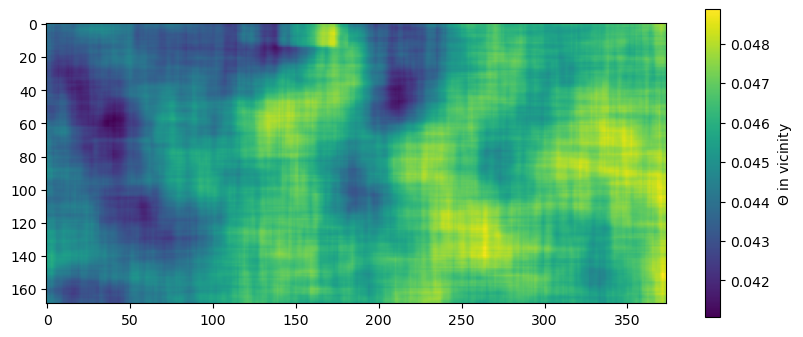

In [45]:
match_pattern = '2008-02-02'
data, headers, waves, tmaps, tmap_mean = process(match_pattern, ds=1, save_tmaps=False, show_plots=False)
plot_theta_in_vicinity(np.mean([tmaps[0], tmaps[2]], axis=0), window_size=350, stride=10)

As a sanity check: This is an observation triplet that came with 2x2 binning, rather than us applying our own binning. Its Theta isn't substantially different.

2008-02-29T10:34:12.099
2008-02-29T10:34:15.304
2008-02-29T10:34:18.497


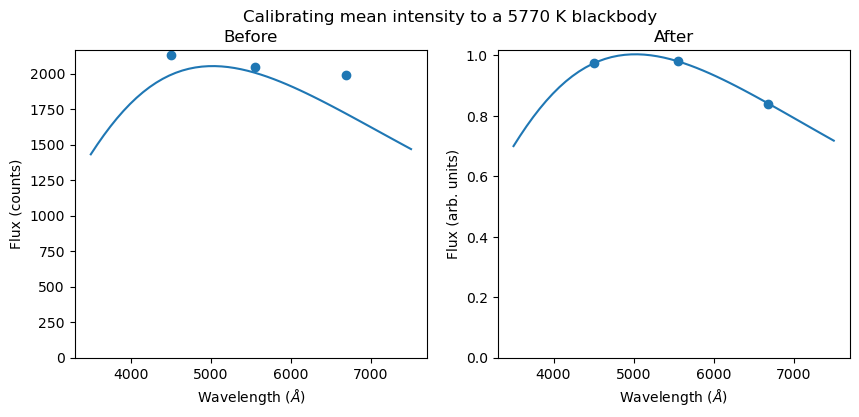

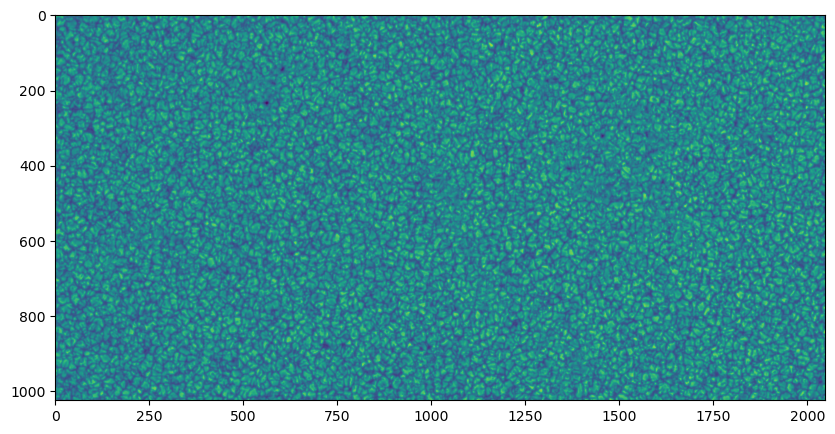

The images are zoomed slightly relative to each other. By plotting the difference between two of them, we can see that the scaling is relative to the upper-center.


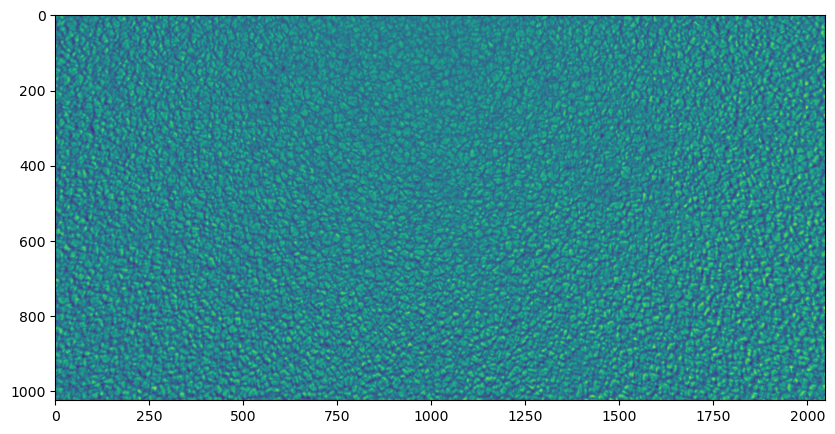

Aligning...
Scale factors: 0.99195, 0.99601
(Nominal: 0.99218, 0.99641)
Translations: (7.913, 0.175), (4.473, 0.002)
(Normal is about (15.4, 0), (9, 0))
Aligned images saved


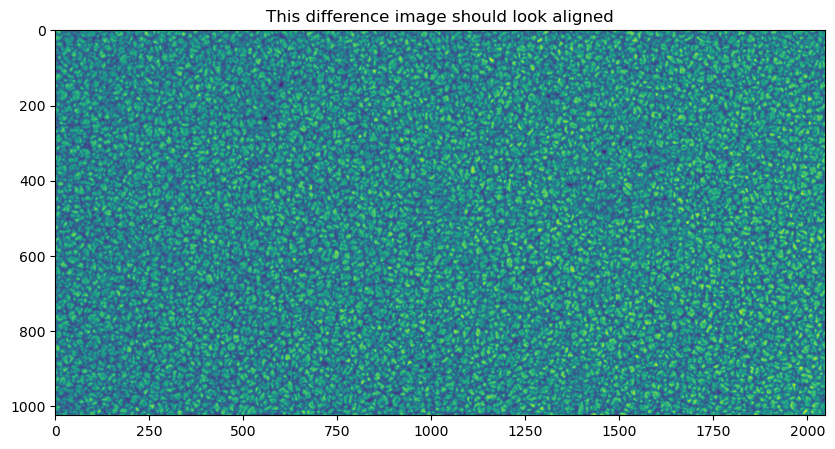

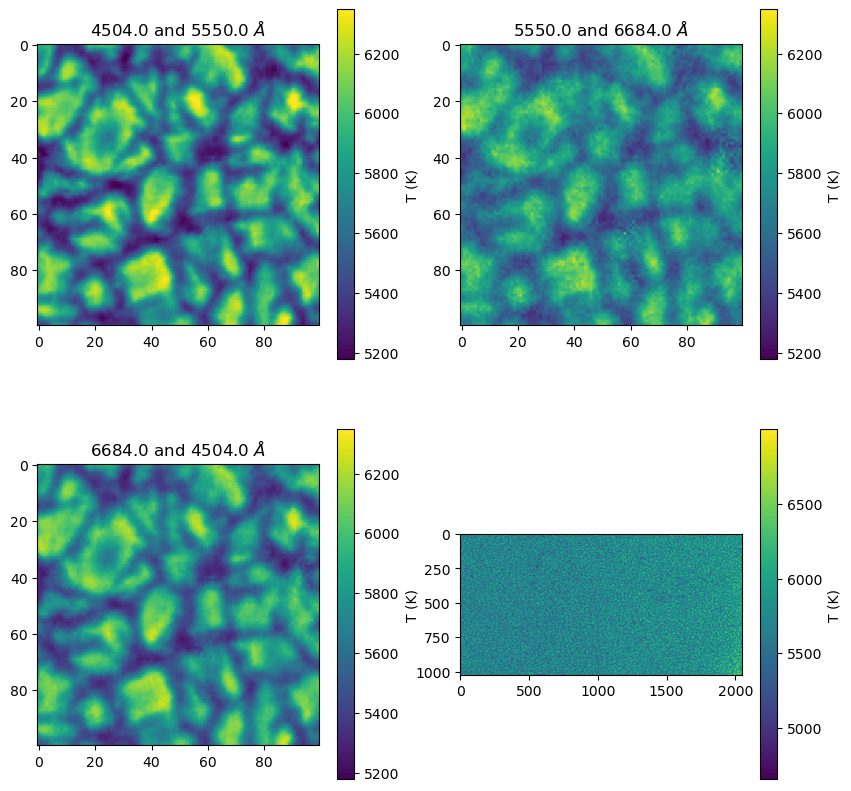

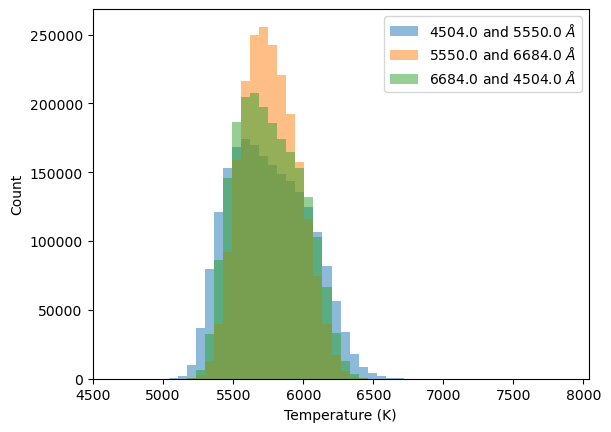

Theta12:  0.04751190603577203
Theta23:  0.03358486699577027
Theta31:  0.03962145909078343
Theta mean:  0.0387537204417042


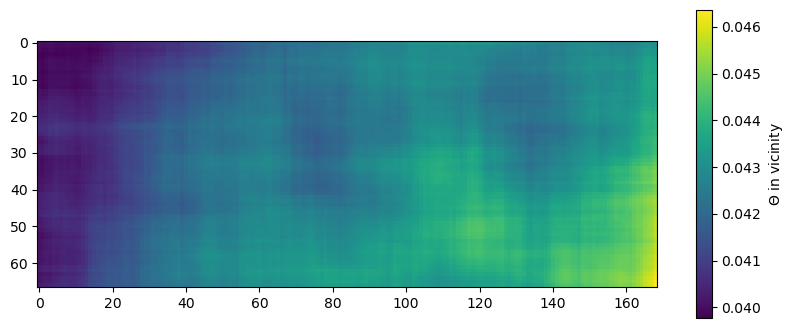

In [74]:
match_pattern = '2008-02-29'
data, headers, waves, tmaps, tmap_mean = process(match_pattern)

# Looking at all the Theta values

We compute theta from all the temperature maps we saved earlier

In [27]:
thetas12 = []
thetas23 = []
thetas31 = []
maps_mean = []

dirs = os.listdir()
for fname in sorted(dirs):
    if not fname.startswith('tmap-') or not fname.endswith('.npy') or '1x1' not in fname:
        continue
    tmaps = np.load(fname)
    thetas12.append(calc_theta(tmaps[0]))
    thetas23.append(calc_theta(tmaps[1]))
    thetas31.append(calc_theta(tmaps[2]))
    mean_map = np.mean([tmaps[0], tmaps[2]], axis=0)
    maps_mean.append(mean_map)
    print(f"<T> = {np.mean(mean_map):.2f} K")

<T> = 5757.95 K
<T> = 5758.10 K
<T> = 5757.97 K
<T> = 5759.87 K
<T> = 5760.49 K
<T> = 5757.92 K
<T> = 5758.44 K
<T> = 5758.77 K
<T> = 5758.49 K
<T> = 5758.49 K


Final mean Theta is 0.0456708403559046
Final mean is 263.00232621738405 K


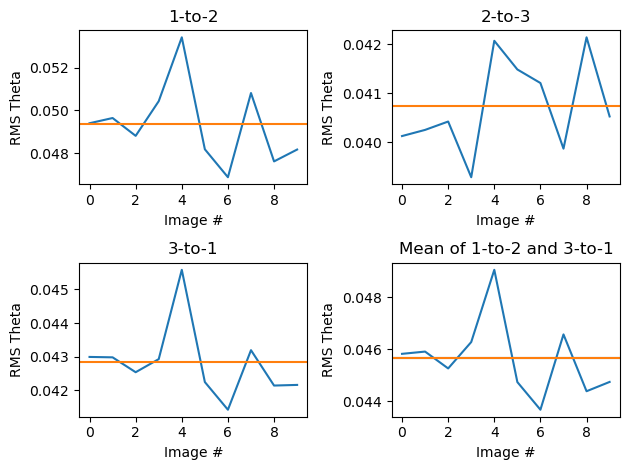

In [28]:
plt.subplot(221)
plt.plot(thetas12)
plt.axhline(rms(thetas12), color="C1")
plt.title("1-to-2")
plt.xlabel("Image #")
plt.ylabel("RMS Theta")

plt.subplot(222)
plt.plot(thetas23)
plt.axhline(rms(thetas23), color="C1")
plt.title("2-to-3")
plt.xlabel("Image #")
plt.ylabel("RMS Theta")

plt.subplot(223)
plt.plot(thetas31)
plt.axhline(rms(thetas31), color="C1")
plt.title("3-to-1")
plt.xlabel("Image #")
plt.ylabel("RMS Theta")

plt.subplot(224)
plt.plot(list(map(calc_theta, maps_mean)))
overall_mean = calc_theta(np.array(maps_mean))
print(f"Final mean Theta is {overall_mean}")
print(f"Final mean is {calc_theta_abs(np.array(maps_mean))} K")
plt.axhline(overall_mean)
plt.axhline(rms([ calc_theta(m) for m in maps_mean ]), color="C1")
plt.title("Mean of 1-to-2 and 3-to-1")
plt.xlabel("Image #")
plt.ylabel("RMS Theta")

plt.tight_layout()

Theta is plotted as a function of image number (or, temperature map number) for each of the three possible line ratios, to visualize any variation between line ratios or between observation triplets.

Text(0.5, 0, 'T (K)')

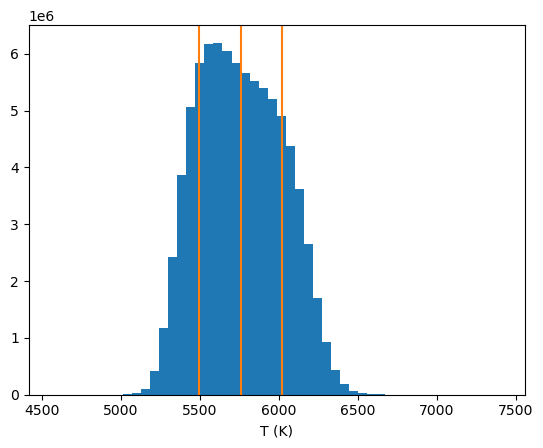

In [29]:
arr = np.asarray(maps_mean)
plt.hist(arr.flatten(), bins=50);
mean = np.mean(arr)
std = np.std(arr)
plt.axvline(mean, color='C1')
plt.axvline(mean + std, color='C1')
plt.axvline(mean - std, color='C1')
plt.xlabel("T (K)")

This is a histogram of T values (the mean of the temperatures from the 1-to-2 and 3-to-1 ratios) across all pixels across all observation triplets, with the mean and +/- 1 sigma marked